## Bhavesh Rajesh Talreja

## CWID: A20516822

## Assignment 3 - Generative Adversarial Network Programming (Full points: 100)

This assignment is more like a tutorial.

### About Grading
(10 points)
Essentially, you need to go through all the coding details we provide to you, and experiment with it. We will grade you by checking the history to see if you have run the code.
(60 points) You need to complete certain code segments. If you don't completely go through the tutorial, you might fail this part.
(30 points)
Finally, you should adjust the hyperparameters to achieve a reasonable result (a lower printed loss) in order to receive a high grade.

### Content
In this assignment (with tutorial), you're going to create your first generative adversarial network (GAN). Specifically, you need to build and train a GAN that can generate hand-written images of digits (0 to 9). You will be using PyTorch in this specialization, so if you're not familiar with this framework, you may find the [PyTorch documentation](https://pytorch.org/docs/stable/index.html) useful. The hints will also often include links to relevant documentation.

### Warning
If you encounter code errors (bugs), even in the tutorial, please attempt to resolve them independently, search for solutions using search engines such as Google, or seek advice from fellow classmates (plagiarism is not permitted). Failing to rectify bugs within the assignment or merely writing code without producing executable results will result in a significant deduction of points.

### Objectives
1.   Build the generator and discriminator components of a GAN from scratch.
2.   Create generator and discriminator loss functions.
3.   Train your GAN and visualize the generated images.


### Key Concepts & Review

##### MNIST Dataset
The training images your discriminator will be using is from a dataset called MNIST. It contains 60,000 images of handwritten digits, from 0 to 9. (Google it if you want to see the details.)

You may notice that the images are quite pixelated -- this is because they are all only 28 x 28! The small size of its images makes MNIST ideal for simple training. Additionally, these images are also in black-and-white so only one dimension, or "color channel").

##### Tensor
You will represent the data using [tensors](https://pytorch.org/docs/stable/tensors.html). Tensors are a generalization of matrices: for example, a stack of three matrices with the amounts of red, green, and blue at different locations in a 64 x 64 pixel image is a tensor with the shape 3 x 64 x 64.

Tensors are easy to manipulate and supported by [PyTorch](https://pytorch.org/), the library you will be using. Feel free to explore them more, but you can imagine these as multi-dimensional matrices or vectors!

##### Batches
While you could train your model after generating one image, it is extremely inefficient and leads to less stable training. In GANs, and in deep learning in general, you will process multiple images per training step. These are called batches.

This means that your generator will generate an entire batch of images and receive the discriminator's feedback on each before updating the model. The same goes for the discriminator, it will calculate its loss on the entire batch of generated images as well as on the reals before the model is updated.

In [37]:
import torch

print(torch.__version__)

if torch.cuda.is_available():
    print("GPU is available.")
else:
    print("GPU is not available.")


2.1.0+cu118
GPU is available.


# Tutorial (10 points)

You will begin by importing some useful packages and the dataset you will use to build and train your GAN.

In [20]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST # Training dataset
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in a uniform grid.
    '''
    image_unflat = image_tensor.view(-1, *size).detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

## Generator
The first step is to build the generator component.

You will start by creating a function to make a single layer/block for the generator's neural network. Each block should include a [linear transformation](https://pytorch.org/docs/stable/generated/torch.nn.Linear.html) to map to another shape, a [batch normalization](https://pytorch.org/docs/stable/generated/torch.nn.BatchNorm1d.html) for stabilization, and finally a non-linear activation function (you use a [ReLU here](https://pytorch.org/docs/master/generated/torch.nn.ReLU.html)) so the output can be transformed in complex ways.

In [21]:
def get_generator_block(input_dim, output_dim):
    '''
    Function for returning a block of the generator's neural network
    given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a generator neural network layer, with a linear transformation
          followed by a batch normalization and then a relu activation
    '''
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.BatchNorm1d(output_dim),
        nn.ReLU(inplace=True),
    )

In [22]:
# Verify the generator block function
def test_gen_block(in_features, out_features, num_test=1000):
    block = get_generator_block(in_features, out_features)

    # Check the three parts
    assert len(block) == 3
    assert type(block[0]) == nn.Linear
    assert type(block[1]) == nn.BatchNorm1d
    assert type(block[2]) == nn.ReLU

    # Check the output shape
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)
    assert tuple(test_output.shape) == (num_test, out_features)
    assert test_output.std() > 0.55
    assert test_output.std() < 0.65

test_gen_block(25, 12)
test_gen_block(15, 28)
print("Success!")

Success!


Now you can build the generator class. It will take 3 values:

*   The noise vector dimension
*   The image dimension
*   The initial hidden dimension

Using these values, the generator will build a neural network with 5 layers/blocks. Beginning with the noise vector, the generator will apply non-linear transformations via the block function until the tensor is mapped to the size of the image to be outputted (the same size as the real images from MNIST). You will need to fill in the code for final layer since it is different than the others. The final layer does not need a normalization or activation function, but does need to be scaled with a [sigmoid function](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html).

Finally, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">Generator</font></code></b>
</font>
</summary>

1. The output size of the final linear transformation should be im_dim, but remember you need to scale the outputs between 0 and 1 using the sigmoid function.
2. [nn.Linear](https://pytorch.org/docs/master/generated/torch.nn.Linear.html) and [nn.Sigmoid](https://pytorch.org/docs/master/generated/torch.nn.Sigmoid.html) will be useful here.
</details>


In [23]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
          (MNIST images are 28 x 28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_dim=784, hidden_dim=128):
        super(Generator, self).__init__()
        # Build the neural network
        self.gen = nn.Sequential(
            get_generator_block(z_dim, hidden_dim),
            get_generator_block(hidden_dim, hidden_dim * 2),
            get_generator_block(hidden_dim * 2, hidden_dim * 4),
            get_generator_block(hidden_dim * 4, hidden_dim * 8),

            nn.Linear(hidden_dim * 8, im_dim),
            nn.Sigmoid()
        )
    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return self.gen(noise)

    def get_gen(self):
        '''
        Returns:
            the sequential model
        '''
        return self.gen

In [24]:
# Verify the generator class
def test_generator(z_dim, im_dim, hidden_dim, num_test=10000):
    gen = Generator(z_dim, im_dim, hidden_dim).get_gen()

    # Check there are six modules in the sequential part
    assert len(gen) == 6
    test_input = torch.randn(num_test, z_dim)
    test_output = gen(test_input)

    # Check that the output shape is correct
    assert tuple(test_output.shape) == (num_test, im_dim)
    assert test_output.max() < 1, "Make sure to use a sigmoid"
    assert test_output.min() > 0, "Make sure to use a sigmoid"
    assert test_output.std() > 0.05, "Don't use batchnorm here"
    assert test_output.std() < 0.15, "Don't use batchnorm here"

test_generator(5, 10, 20)
test_generator(20, 8, 24)
print("Success!")

Success!


## Noise
To be able to use your generator, you will need to be able to create noise vectors. The noise vector z has the important role of making sure the images generated from the same class don't all look the same -- think of it as a random seed. You will generate it randomly using PyTorch by sampling random numbers from the normal distribution. Since multiple images will be processed per pass, you will generate all the noise vectors at once.

Note that whenever you create a new tensor using torch.ones, torch.zeros, or torch.randn, you either need to create it on the target device, e.g. `torch.ones(3, 3, device=device)`, or move it onto the target device using `torch.ones(3, 3).to(device)`. You do not need to do this if you're creating a tensor by manipulating another tensor or by using a variation that defaults the device to the input, such as `torch.ones_like`. In general, use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros` where possible.

<details>

<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">get_noise</font></code></b>
</font>
</summary>

1.
You will probably find [torch.randn](https://pytorch.org/docs/master/generated/torch.randn.html) useful here.
</details>

In [25]:
def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim),
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    # NOTE: To use this on GPU with device='cuda', make sure to pass the device
    # argument to the function you use to generate the noise.
    return torch.randn(n_samples, z_dim, device=device)

In [26]:
# Verify the noise vector function
def test_get_noise(n_samples, z_dim, device='cpu'):
    noise = get_noise(n_samples, z_dim, device)

    # Make sure a normal distribution was used
    assert tuple(noise.shape) == (n_samples, z_dim)
    assert torch.abs(noise.std() - torch.tensor(1.0)) < 0.01
    assert str(noise.device).startswith(device)

test_get_noise(1000, 100, 'cpu')
if torch.cuda.is_available():
    test_get_noise(1000, 32, 'cuda')
    print("Success on gpu!")
else:
    print("Success!")

Success on gpu!


## Discriminator
The second component that you need to construct is the discriminator. As with the generator component, you will start by creating a function that builds a neural network block for the discriminator.

*Note: You use leaky ReLUs to prevent the "dying ReLU" problem, which refers to the phenomenon where the parameters stop changing due to consistently negative values passed to a ReLU, which result in a zero gradient. You will learn more about this in the following lectures!*

In [27]:
def get_discriminator_block(input_dim, output_dim):
    '''
    Discriminator Block
    Function for returning a neural network of the discriminator given input and output dimensions.
    Parameters:
        input_dim: the dimension of the input vector, a scalar
        output_dim: the dimension of the output vector, a scalar
    Returns:
        a discriminator neural network layer, with a linear transformation
          followed by an nn.LeakyReLU activation with negative slope of 0.2
          (https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html)
    '''
    return nn.Sequential(
        nn.Linear(input_dim, output_dim),
        nn.LeakyReLU(0.2, inplace=True)
    )

In [28]:
# Verify the discriminator block function
def test_disc_block(in_features, out_features, num_test=10000):
    block = get_discriminator_block(in_features, out_features)

    # Check there are two parts
    assert len(block) == 2
    test_input = torch.randn(num_test, in_features)
    test_output = block(test_input)

    # Check that the shape is right
    assert tuple(test_output.shape) == (num_test, out_features)

    # Check that the LeakyReLU slope is about 0.2
    assert -test_output.min() / test_output.max() > 0.1
    assert -test_output.min() / test_output.max() < 0.3
    assert test_output.std() > 0.3
    assert test_output.std() < 0.5

test_disc_block(25, 12)
test_disc_block(15, 28)
print("Success!")

Success!


Now you can use these blocks to make a discriminator! The discriminator class holds 2 values:

*   The image dimension
*   The hidden dimension

The discriminator will build a neural network with 4 layers. It will start with the image tensor and transform it until it returns a single number (1-dimension tensor) output. This output classifies whether an image is fake or real. Note that you do not need a sigmoid after the output layer since it is included in the loss function. Finally, to use your discrimator's neural network you are given a forward pass function that takes in an image tensor to be classified.


In [29]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_dim: the dimension of the images, fitted for the dataset used, a scalar
            (MNIST images are 28x28 = 784 so that is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_dim=784, hidden_dim=128):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            get_discriminator_block(im_dim, hidden_dim * 4),
            get_discriminator_block(hidden_dim * 4, hidden_dim * 2),
            get_discriminator_block(hidden_dim * 2, hidden_dim),
            # Hint: You want to transform the final output into a single value,
            #       so add one more linear map.
            nn.Linear(hidden_dim, 1)
        )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_dim)
        '''
        return self.disc(image)

    # Needed for grading
    def get_disc(self):
        '''
        Returns:
            the sequential model
        '''
        return self.disc

In [30]:
# Verify the discriminator class
def test_discriminator(z_dim, hidden_dim, num_test=100):

    disc = Discriminator(z_dim, hidden_dim).get_disc()

    # Check there are three parts
    assert len(disc) == 4

    # Check the linear layer is correct
    test_input = torch.randn(num_test, z_dim)
    test_output = disc(test_input)
    assert tuple(test_output.shape) == (num_test, 1)

    # Make sure there's no sigmoid
    assert test_input.max() > 1
    assert test_input.min() < -1

test_discriminator(5, 10)
test_discriminator(20, 8)
print("Success!")

Success!


# (60 points) Complete the missing code
# (30 points) Turning hyperparameters to get a great performance (with lower printed loss).

Now you can put it all together!
First, you will set your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type, here using a GPU (which runs CUDA), not CPU

Next, you will load the MNIST dataset as tensors using a dataloader.

In [31]:
# Set your parameters
criterion = nn.BCEWithLogitsLoss()
n_epochs = 100
z_dim = 100
display_step = 500
batch_size = 100
lr = 0.0002

In [32]:
# Load MNIST dataset as tensors
dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    batch_size=batch_size,
    shuffle=True)

device = 'cuda' # or 'cpu'

Now, you can initialize your generator, discriminator, and optimizers. Note that each optimizer only takes the parameters of one particular model, since we want each optimizer to optimize only one of the models.

In [33]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

Before you train your GAN, you will need to create functions to calculate the discriminator's loss and the generator's loss. This is how the discriminator and generator will know how they are doing and improve themselves. Since the generator is needed when calculating the discriminator's loss, you will need to call .detach() on the generator result to ensure that only the discriminator is updated!

Remember that you have already defined a loss function earlier (`criterion`) and you are encouraged to use `torch.ones_like` and `torch.zeros_like` instead of `torch.ones` or `torch.zeros` to set the labels. If you use `torch.ones` or `torch.zeros`, you'll need to pass `device=device` to them.

In [34]:
def get_disc_loss(gen, disc, criterion, real, num_images, z_dim, device):
    '''
    Return the loss of the discriminator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare
               the discriminator's predictions to the ground truth reality of the images
               (e.g. fake = 0, real = 1)
        real: a batch of real images
        num_images: the number of images the generator should produce,
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        disc_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch (num_images) of fake images.
    #            Make sure to pass the device argument to the noise.
    #       2) Get the discriminator's prediction of the fake image
    #            and calculate the loss. Don't forget to detach the generator!
    #            (Remember the loss function you set earlier -- criterion. You need a
    #            'ground truth' tensor in order to calculate the loss.
    #            For example, a ground truth tensor for a fake image is all zeros.)
    #       3) Get the discriminator's prediction of the real image and calculate the loss.
    #       4) Calculate the discriminator's loss by averaging the real and fake loss
    #            and set it to disc_loss.
    #     Note: Please do not use concatenation in your solution. The tests are being updated to
    #           support this, but for now, average the two losses as described in step (4).
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!
    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device=device)
    fake_image_gen = gen(noise)
    fake_image_pred = disc(fake_image_gen.detach())
    fake_image_loss = criterion(fake_image_pred, torch.zeros_like(fake_image_pred))
    real_image_pred = disc(real)
    real_image_loss = criterion(real_image_pred, torch.ones_like(real_image_pred))
    disc_loss = (fake_image_loss + real_image_loss) / 2
    #### END CODE HERE ####
    return disc_loss

In [35]:
def get_gen_loss(gen, disc, criterion, num_images, z_dim, device):
    '''
    Return the loss of the generator given inputs.
    Parameters:
        gen: the generator model, which returns an image given z-dimensional noise
        disc: the discriminator model, which returns a single-dimensional prediction of real/fake
        criterion: the loss function, which should be used to compare
               the discriminator's predictions to the ground truth reality of the images
               (e.g. fake = 0, real = 1)
        num_images: the number of images the generator should produce,
                which is also the length of the real images
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    Returns:
        gen_loss: a torch scalar loss value for the current batch
    '''
    #     These are the steps you will need to complete:
    #       1) Create noise vectors and generate a batch of fake images.
    #           Remember to pass the device argument to the get_noise function.
    #       2) Get the discriminator's prediction of the fake image.
    #       3) Calculate the generator's loss. Remember the generator wants
    #          the discriminator to think that its fake images are real
    #     *Important*: You should NOT write your own loss function here - use criterion(pred, true)!

    #### START CODE HERE ####
    noise = get_noise(num_images, z_dim, device=device)
    fake_image_gen = gen(noise)
    fake_image_pred = disc(fake_image_gen)
    gen_loss = criterion(fake_image_pred, torch.ones_like(fake_image_pred))
    #### END CODE HERE ####
    return gen_loss

Finally, you can put everything together! For each epoch, you will process the entire dataset in batches. For every batch, you will need to update the discriminator and generator using their loss. Note that you may see a loss to be greater than 1, this is okay since binary cross entropy loss can be any positive number for a sufficiently confident wrong guess.

It’s also often the case that the discriminator will outperform the generator, especially at the start, because its job is easier. It's important that neither one gets too good (that is, near-perfect accuracy), which would cause the entire model to stop learning. Balancing the two models is actually remarkably hard to do in a standard GAN.

In addition, be warned that this runs very slowly on a CPU. One way to run this more quickly is to use Google Colab:

1.   Download the .ipynb
2.   Upload it to Google Drive and open it with Google Colab
3.   Make the runtime type GPU (under “Runtime” -> “Change runtime type” -> Select “GPU” from the dropdown)
4.   Replace `device = "cpu"` with `device = "cuda"`
5.   Make sure your `get_noise` function uses the right device -->

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 0, step 500: Generator loss: 7.534632525205608, discriminator loss: 0.13995136873051536


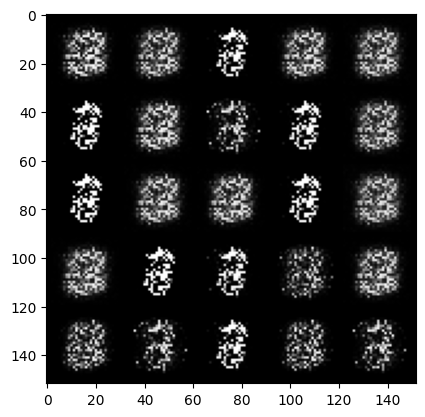

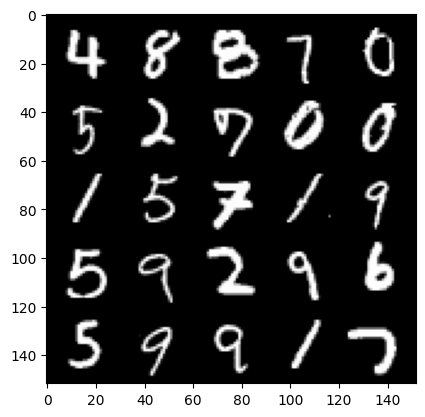

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1, step 1000: Generator loss: 5.108982535362249, discriminator loss: 0.07400811928231278


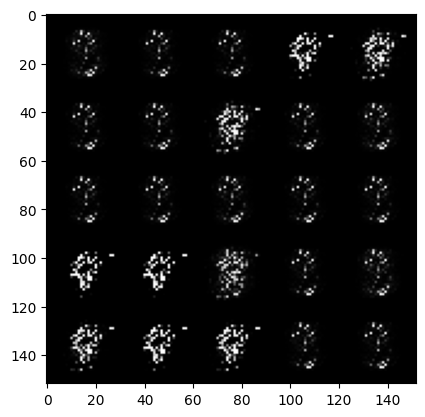

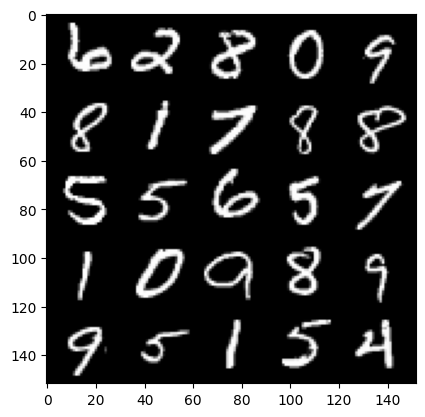

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 2, step 1500: Generator loss: 9.848542724609372, discriminator loss: 0.049176696542883244


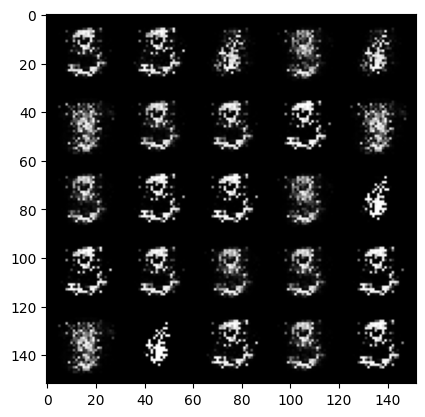

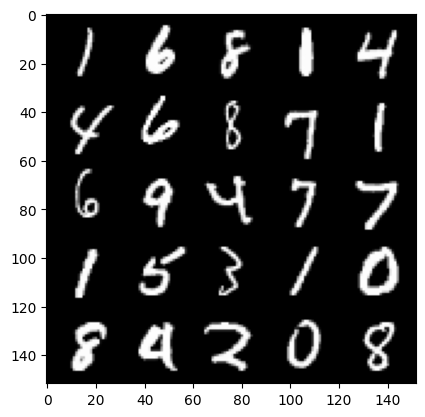

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 3, step 2000: Generator loss: 8.152542433261871, discriminator loss: 0.051420616857241815


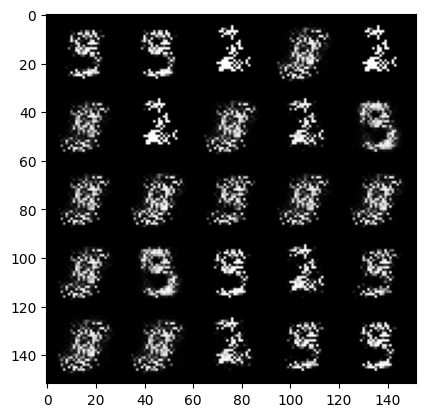

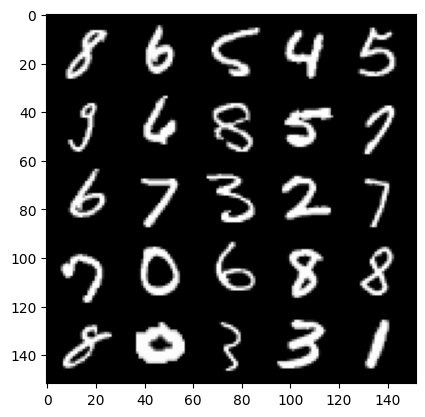

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 4, step 2500: Generator loss: 6.621690777778623, discriminator loss: 0.0451461790218018


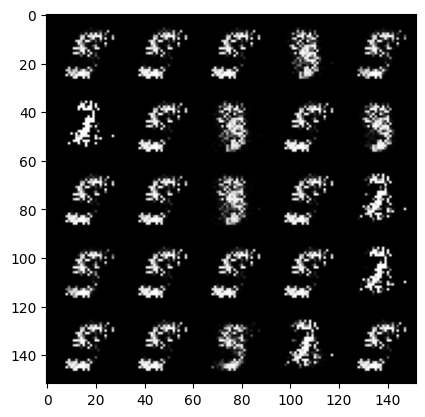

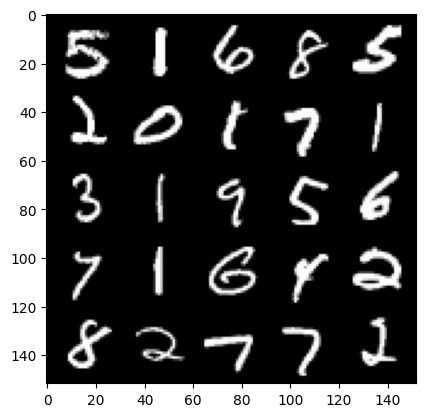

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 5, step 3000: Generator loss: 6.325328188896178, discriminator loss: 0.07945308127813037


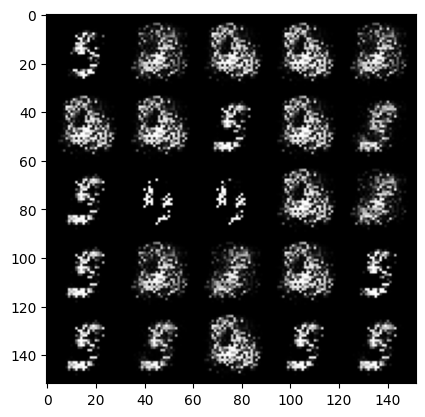

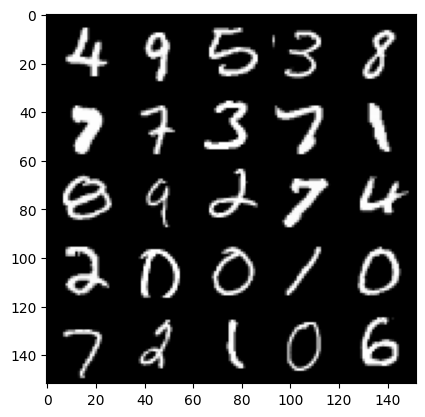

Epoch 5, step 3500: Generator loss: 5.337359626770024, discriminator loss: 0.06864531401917344


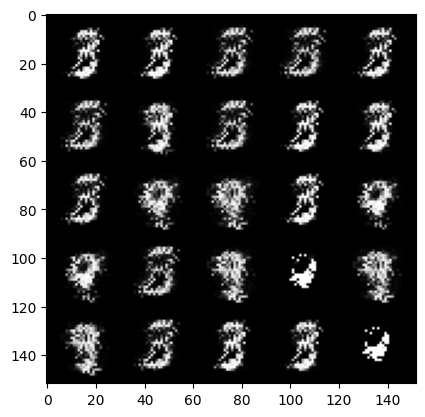

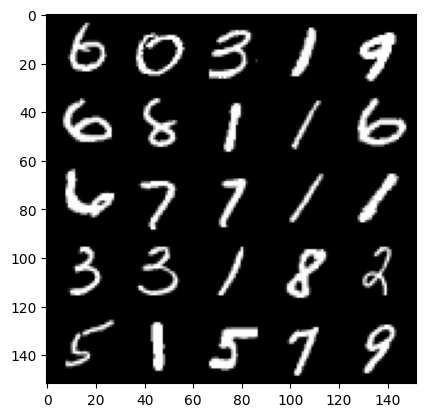

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 6, step 4000: Generator loss: 5.815352808952332, discriminator loss: 0.060791924973018455


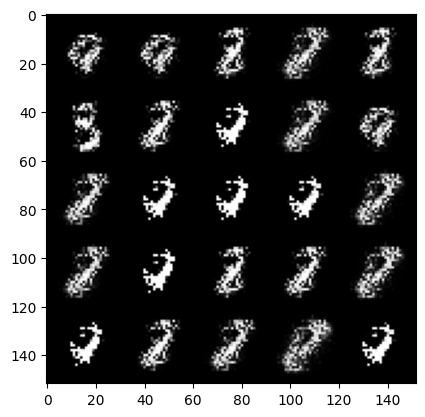

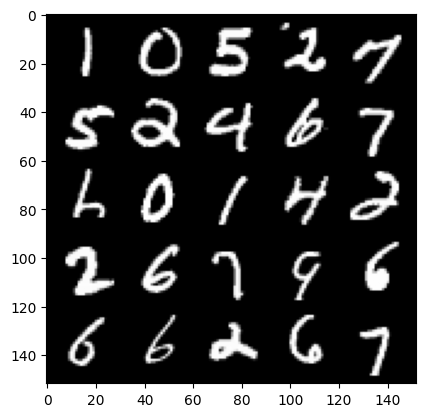

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 7, step 4500: Generator loss: 5.472009158134461, discriminator loss: 0.06956465610768635


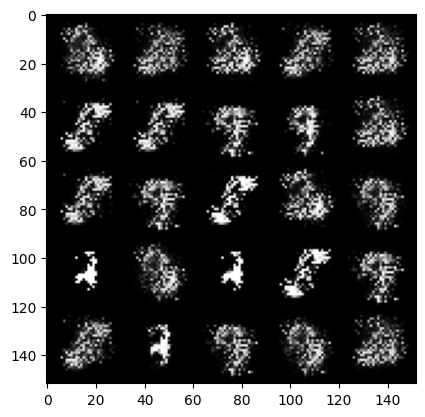

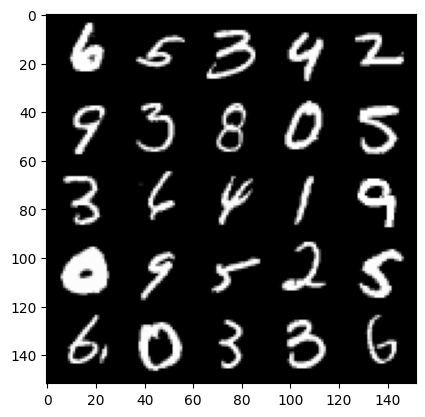

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 8, step 5000: Generator loss: 5.3107848134040845, discriminator loss: 0.07043518622592092


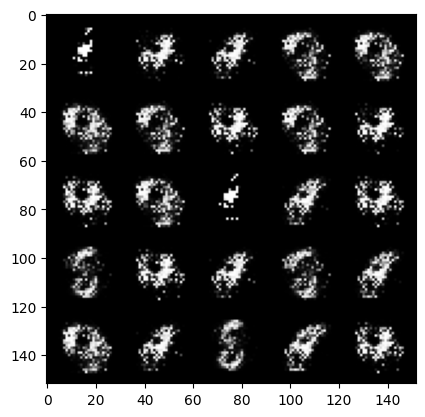

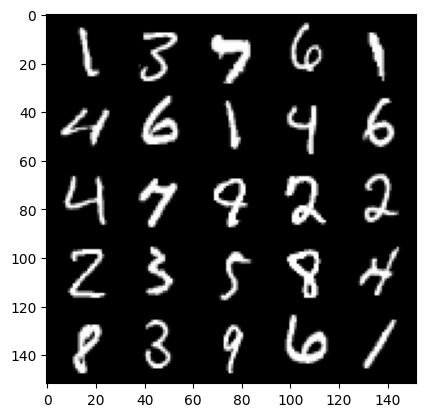

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 9, step 5500: Generator loss: 5.1756080555915895, discriminator loss: 0.06849868929572397


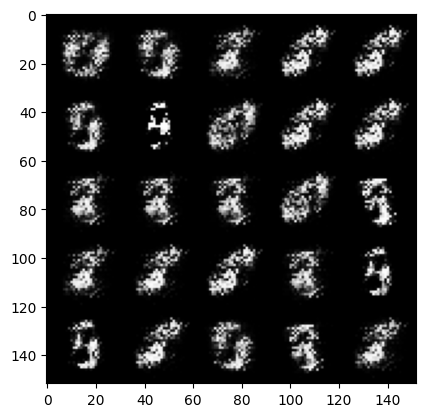

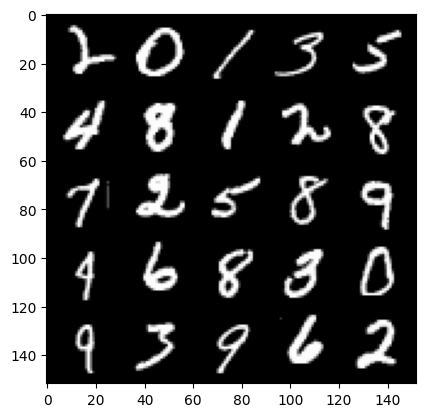

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 10, step 6000: Generator loss: 5.014493973731995, discriminator loss: 0.0726537776933983


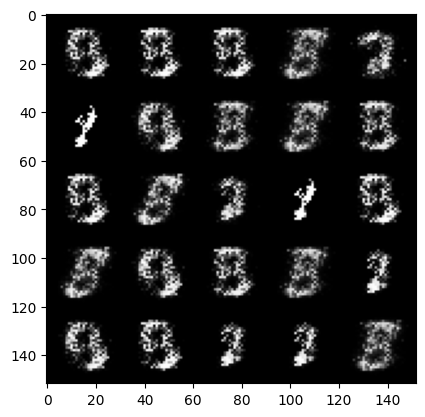

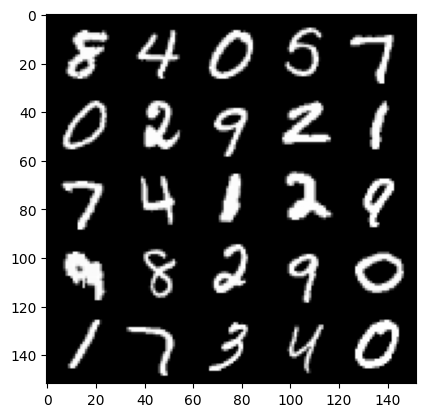

Epoch 10, step 6500: Generator loss: 4.9912111501693674, discriminator loss: 0.07771927235275508


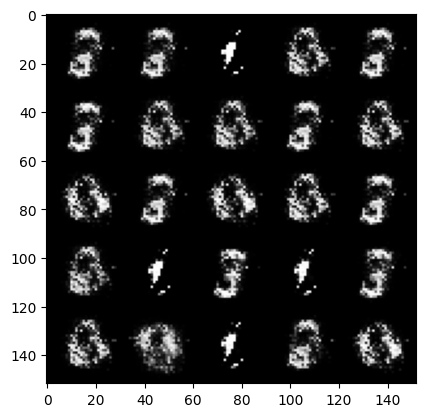

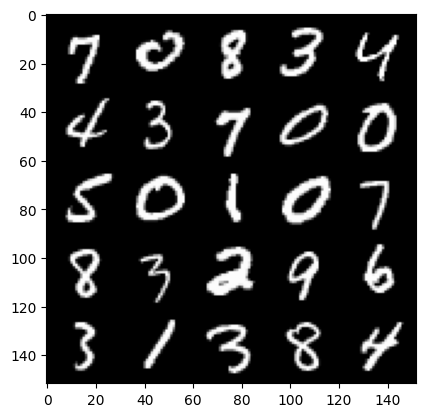

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 11, step 7000: Generator loss: 4.935852949619297, discriminator loss: 0.07027195767126967


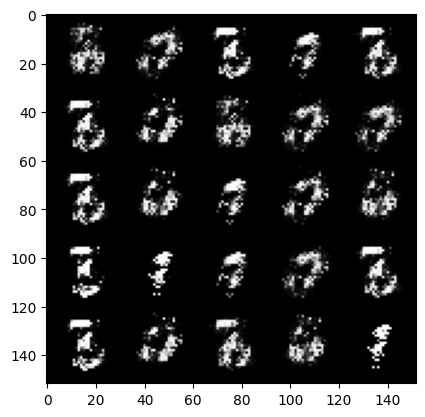

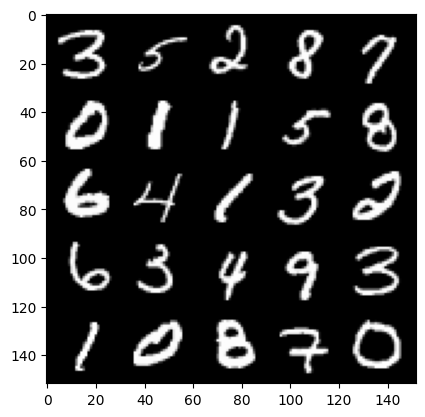

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 12, step 7500: Generator loss: 4.868594060897829, discriminator loss: 0.0857379858288914


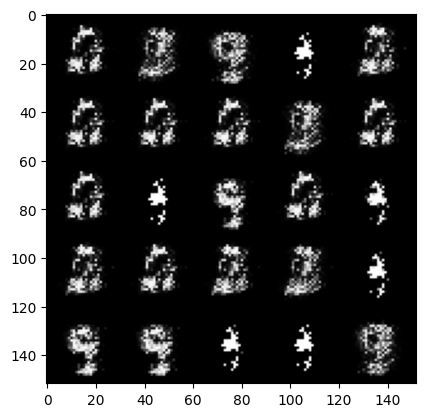

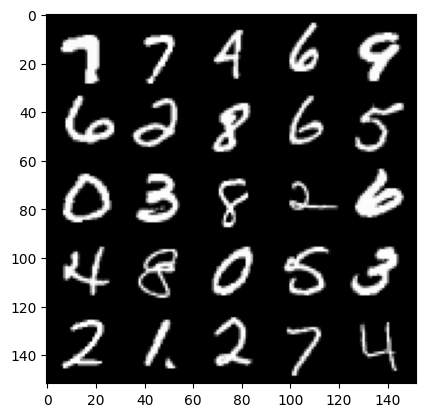

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 13, step 8000: Generator loss: 5.306949548244475, discriminator loss: 0.0666408392423764


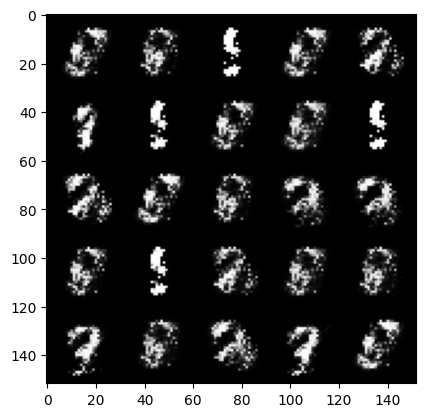

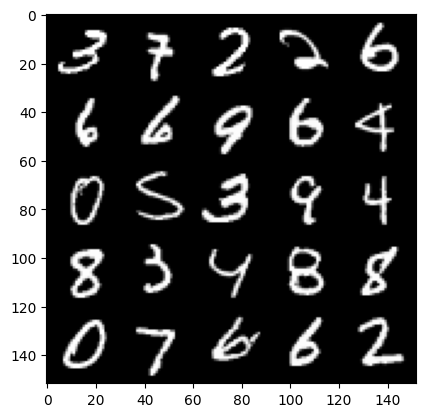

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 14, step 8500: Generator loss: 4.759662491798401, discriminator loss: 0.08146832574531435


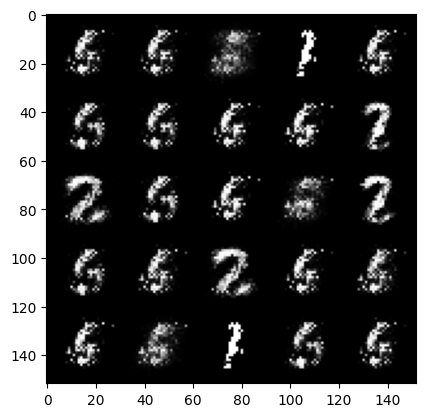

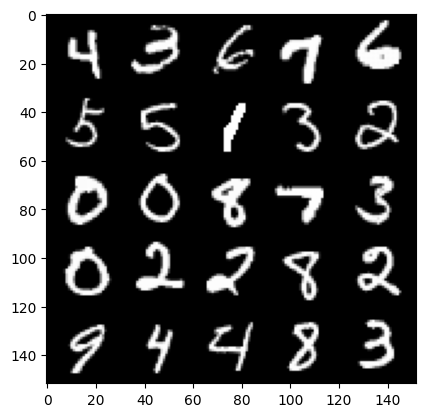

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 15, step 9000: Generator loss: 4.590785245418546, discriminator loss: 0.09153979426436133


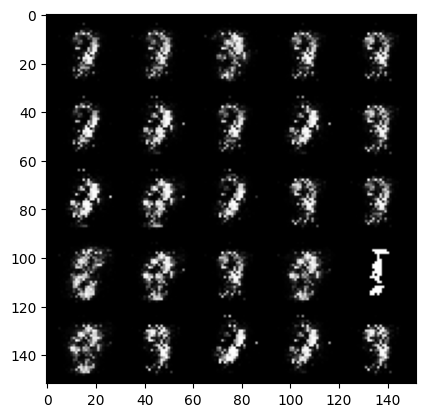

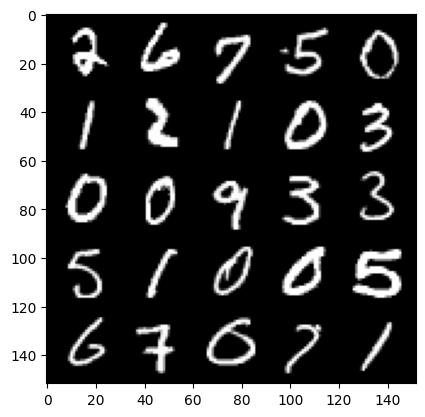

Epoch 15, step 9500: Generator loss: 4.626002878665923, discriminator loss: 0.09037719497084608


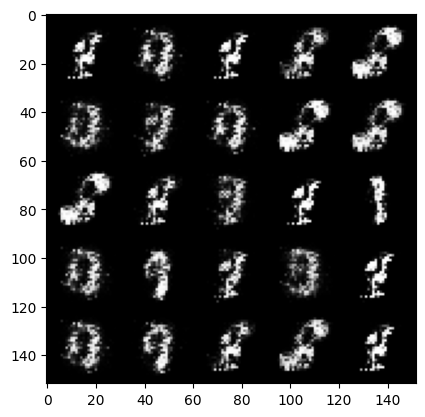

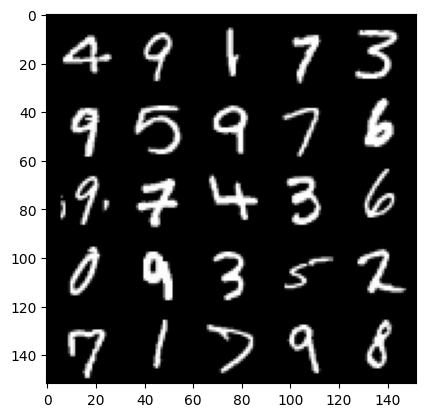

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 16, step 10000: Generator loss: 4.430774106502528, discriminator loss: 0.10342470682412393


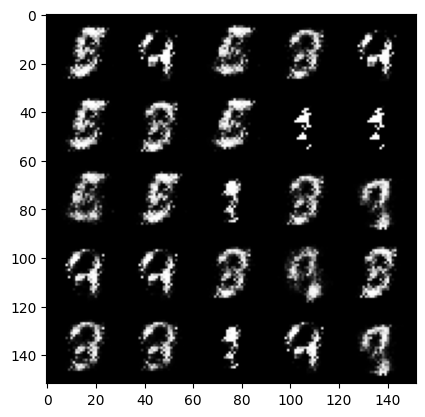

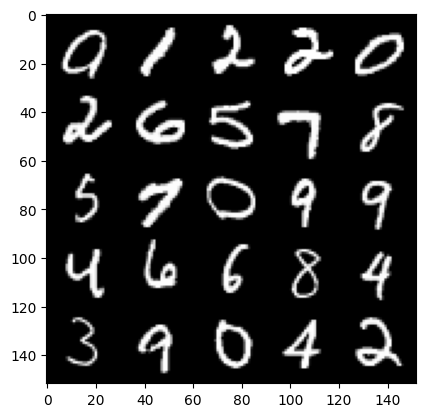

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 17, step 10500: Generator loss: 4.348046807289123, discriminator loss: 0.13149595473706716


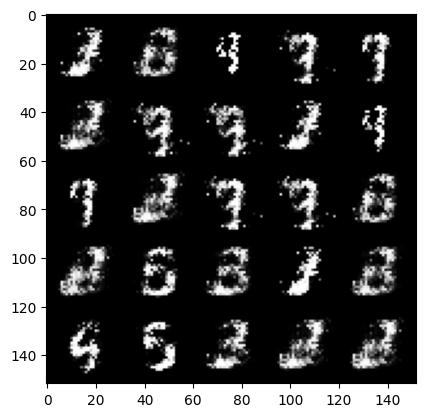

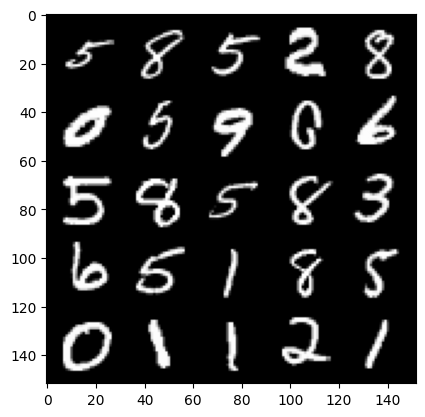

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 18, step 11000: Generator loss: 4.225096062660222, discriminator loss: 0.11701617427170279


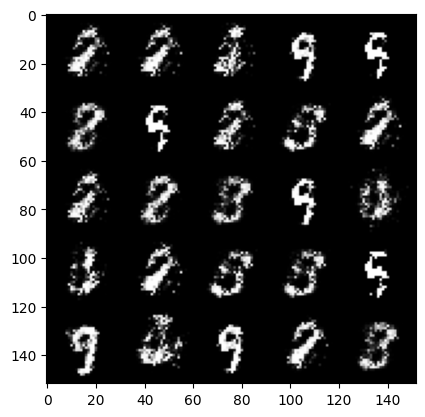

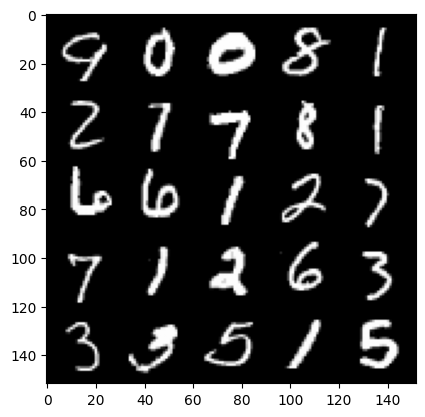

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 19, step 11500: Generator loss: 4.186706482410433, discriminator loss: 0.10252051452174793


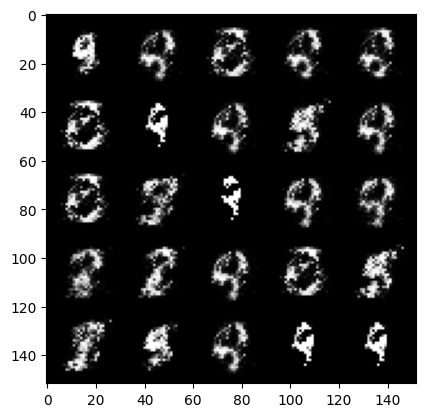

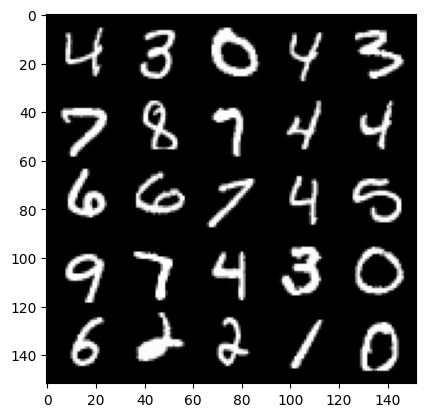

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 20, step 12000: Generator loss: 4.228992707729342, discriminator loss: 0.11980411862581974


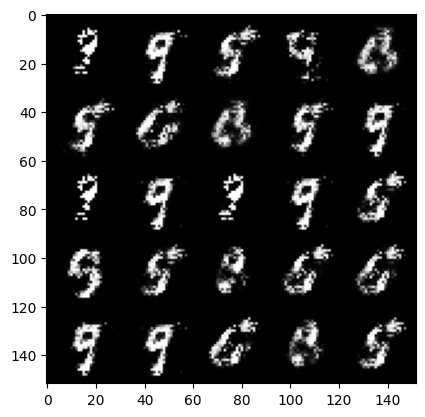

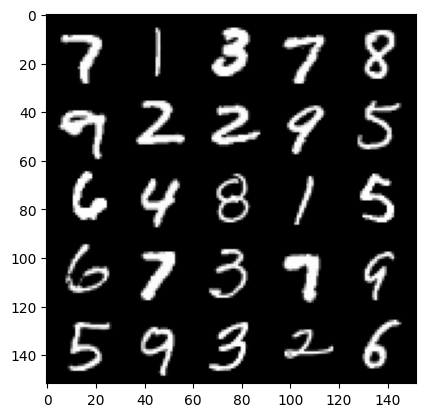

Epoch 20, step 12500: Generator loss: 3.9940323791503918, discriminator loss: 0.12835665286332354


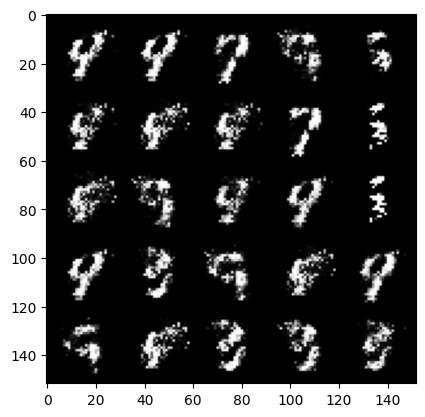

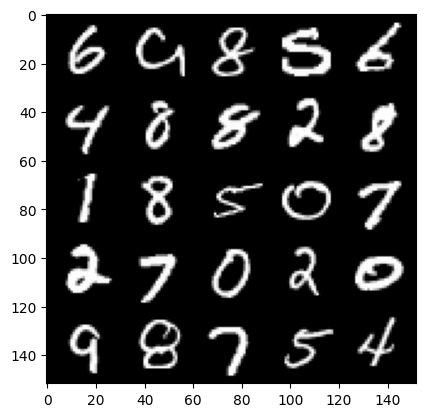

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 21, step 13000: Generator loss: 3.8964444494247448, discriminator loss: 0.13928840298950682


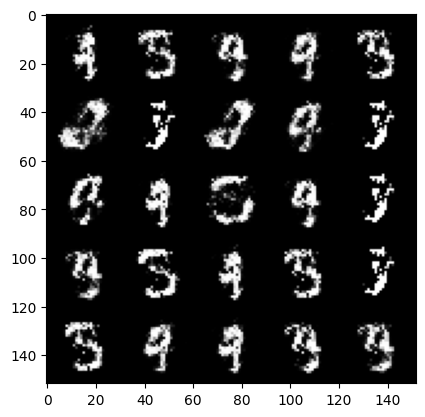

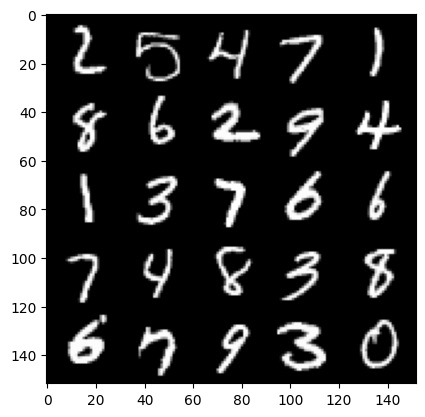

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 22, step 13500: Generator loss: 4.219135253906247, discriminator loss: 0.12007128704711786


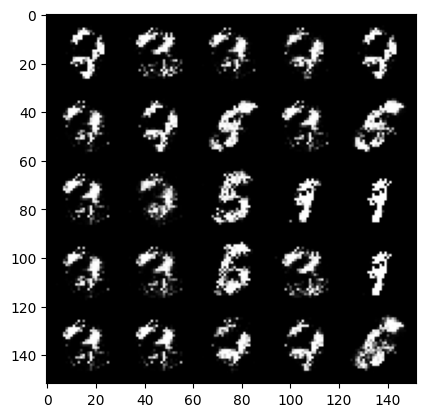

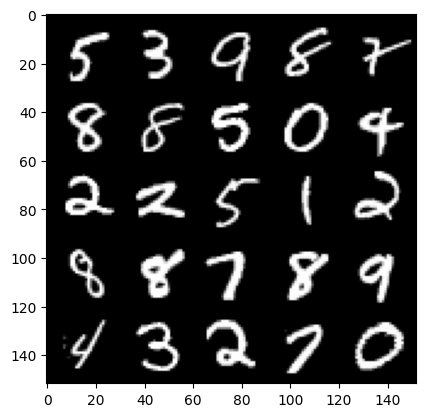

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 23, step 14000: Generator loss: 4.325469312191007, discriminator loss: 0.13005792234092944


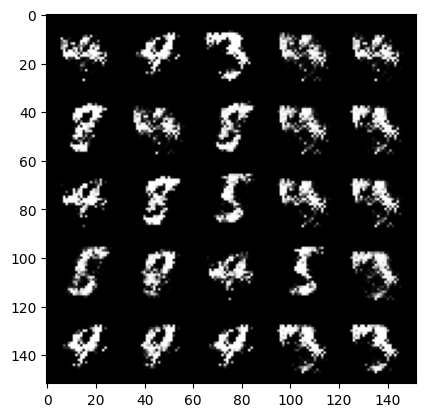

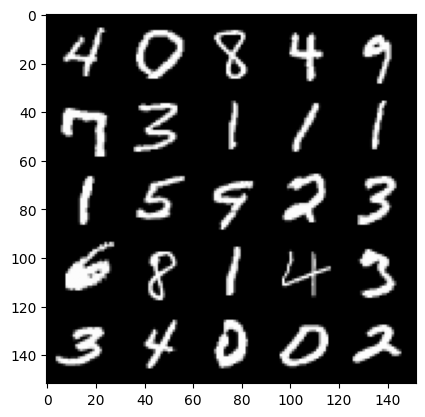

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 24, step 14500: Generator loss: 4.231648633956912, discriminator loss: 0.10365398410335187


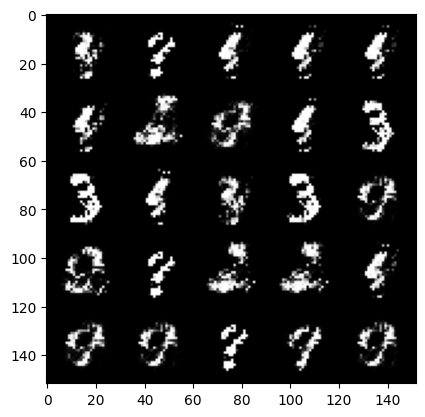

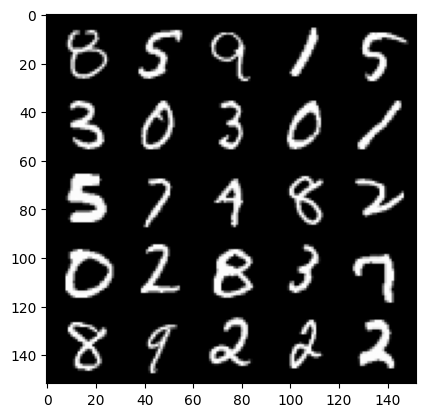

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 25, step 15000: Generator loss: 4.105779610633849, discriminator loss: 0.12308796887844803


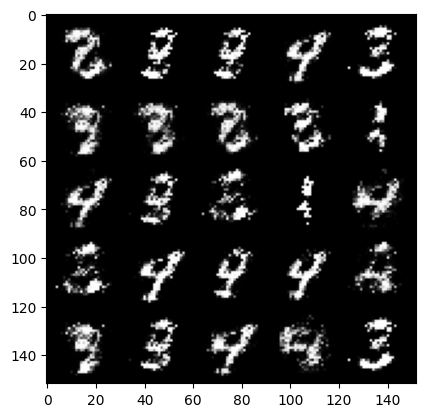

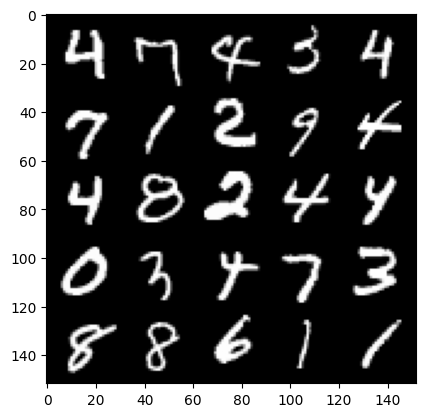

Epoch 25, step 15500: Generator loss: 3.935561014652254, discriminator loss: 0.1389149548634887


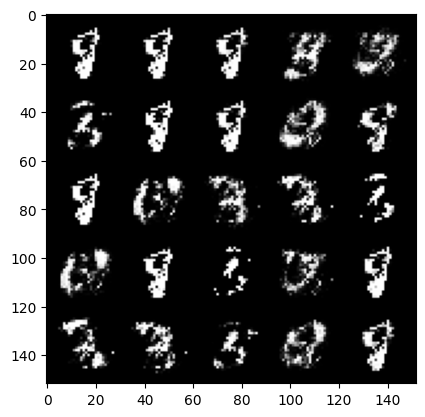

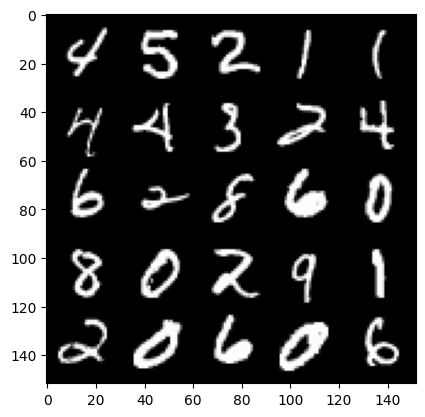

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 26, step 16000: Generator loss: 3.8908971080780064, discriminator loss: 0.12687879323214296


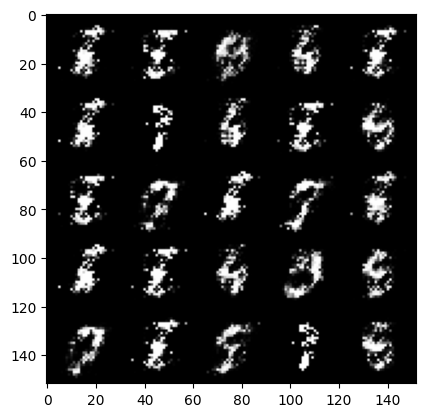

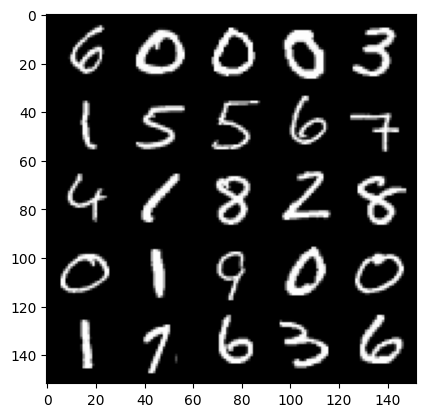

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 27, step 16500: Generator loss: 3.955424407482146, discriminator loss: 0.13067862139642242


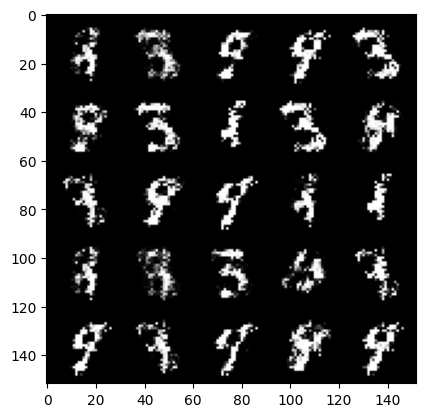

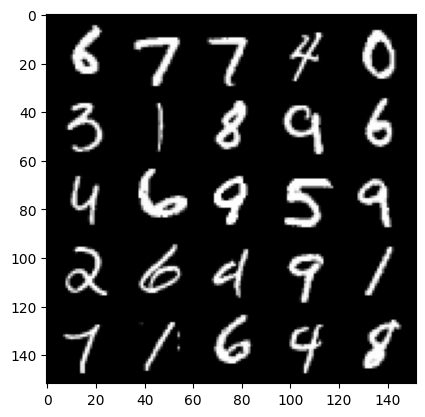

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 28, step 17000: Generator loss: 3.6068134393692026, discriminator loss: 0.13627675085514776


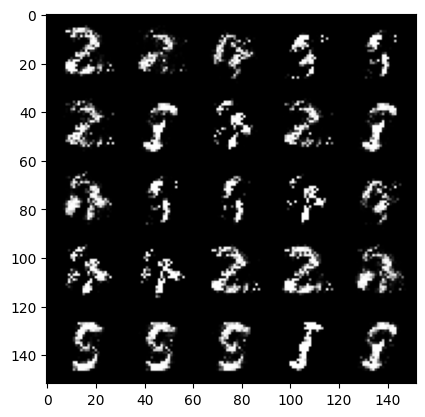

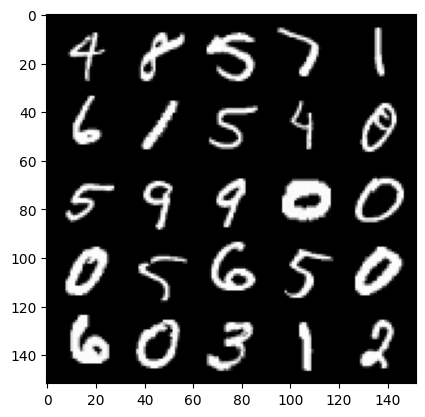

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 29, step 17500: Generator loss: 3.808419809818271, discriminator loss: 0.15234892672300343


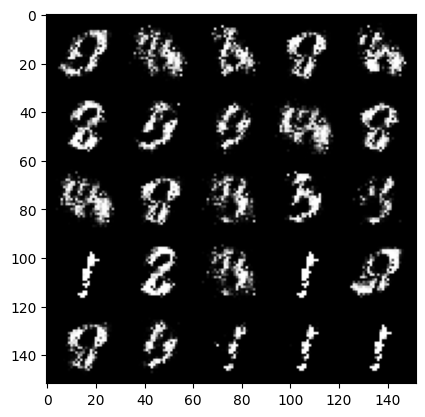

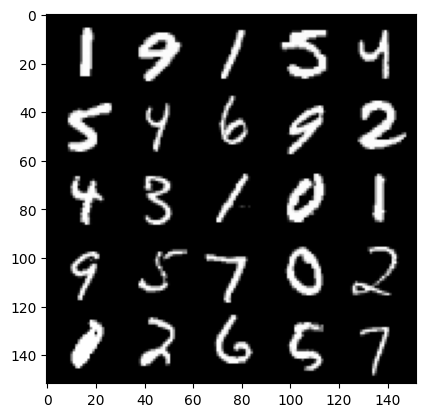

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 30, step 18000: Generator loss: 4.045774108409881, discriminator loss: 0.13278998359665276


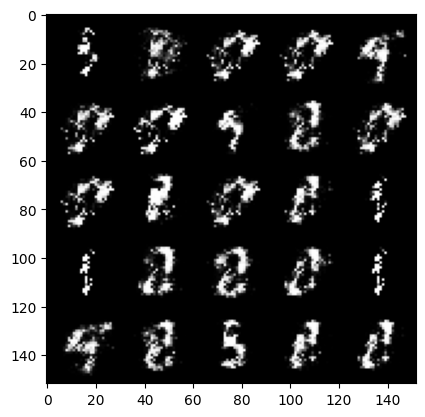

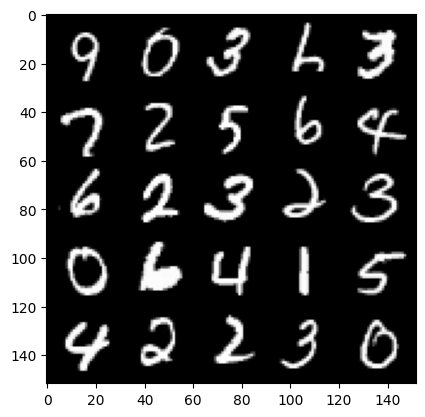

Epoch 30, step 18500: Generator loss: 3.7898488297462447, discriminator loss: 0.1411033640950917


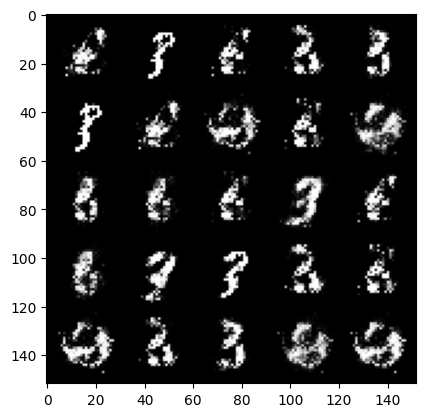

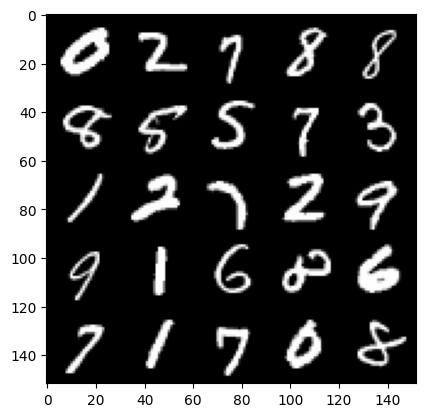

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 31, step 19000: Generator loss: 3.7724116692543026, discriminator loss: 0.13713343478739265


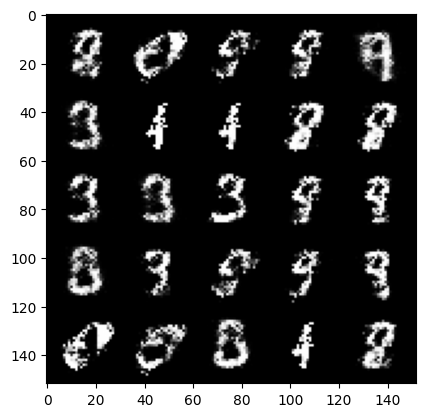

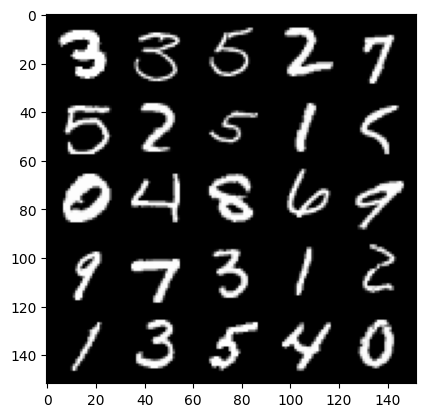

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 32, step 19500: Generator loss: 3.6259190826416012, discriminator loss: 0.1550575900822878


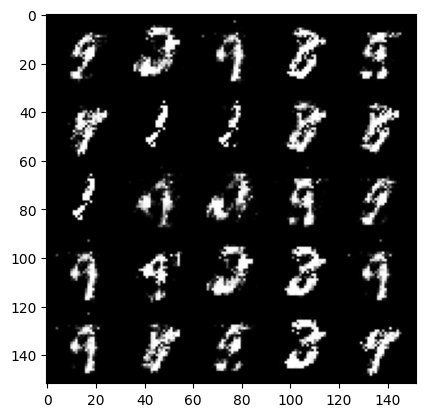

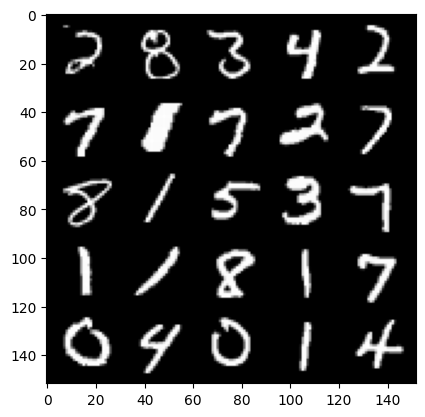

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 33, step 20000: Generator loss: 4.149848189353945, discriminator loss: 0.1328392815515399


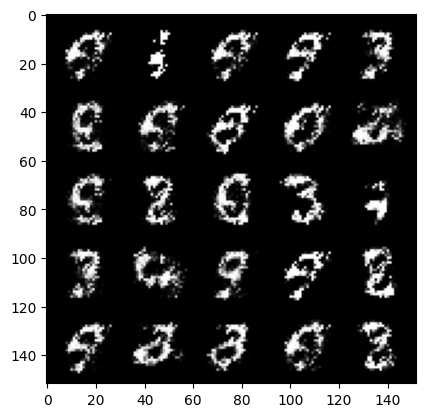

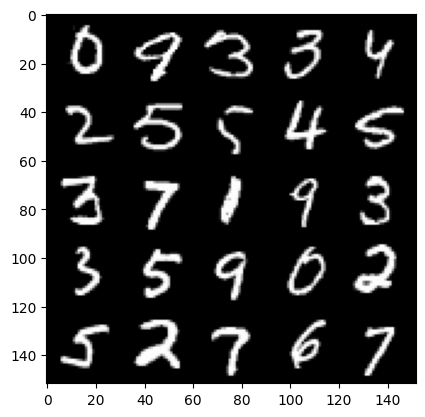

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 34, step 20500: Generator loss: 3.5448766169548027, discriminator loss: 0.15512689936906107


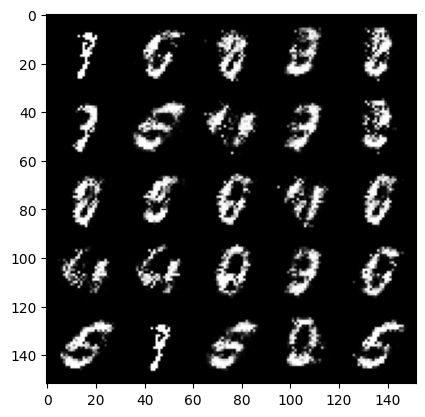

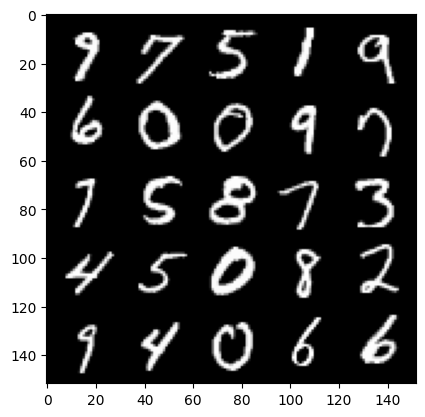

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 35, step 21000: Generator loss: 3.7862241730690016, discriminator loss: 0.15902189996838562


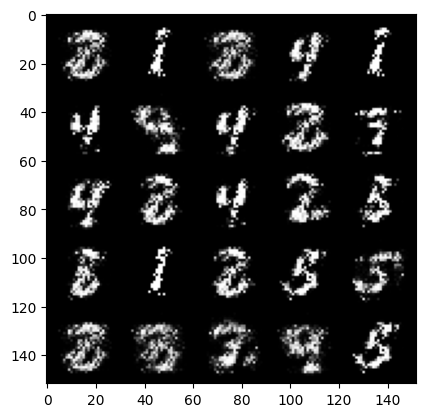

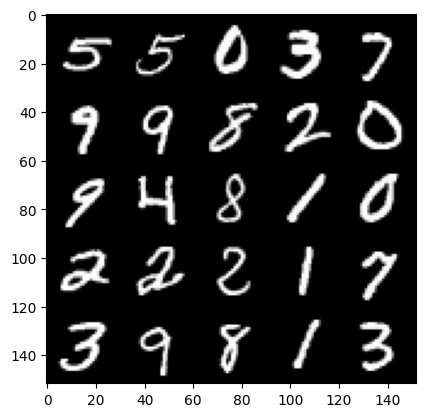

Epoch 35, step 21500: Generator loss: 3.4970719213485713, discriminator loss: 0.15888036808371553


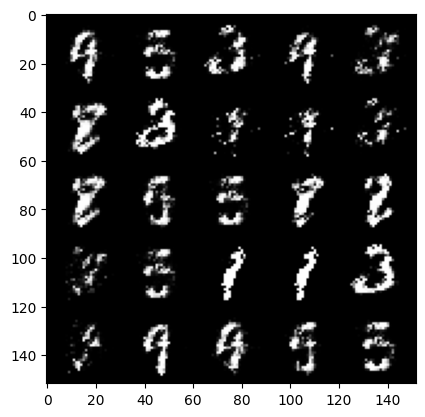

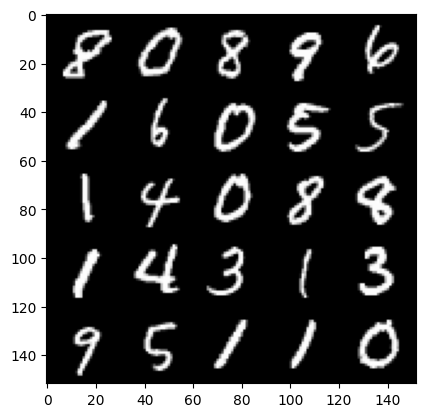

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 36, step 22000: Generator loss: 3.3016081914901756, discriminator loss: 0.16940431448817242


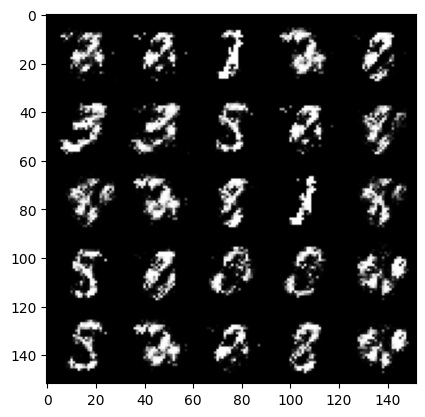

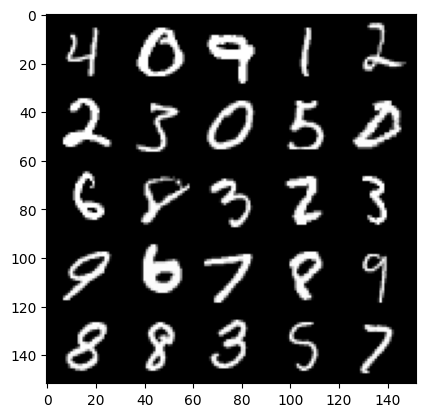

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 37, step 22500: Generator loss: 3.240374923229218, discriminator loss: 0.17347426303476116


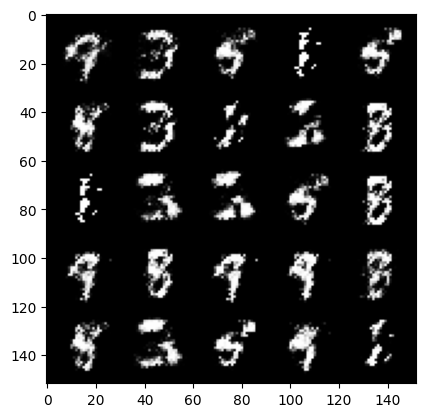

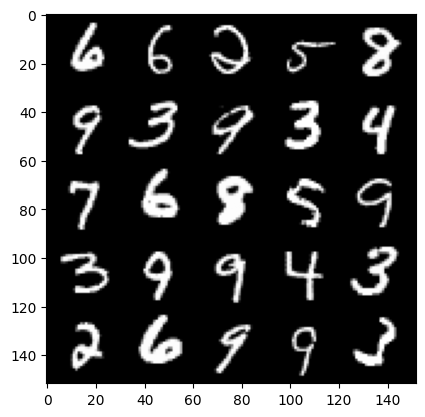

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 38, step 23000: Generator loss: 3.410509726047515, discriminator loss: 0.168657547786832


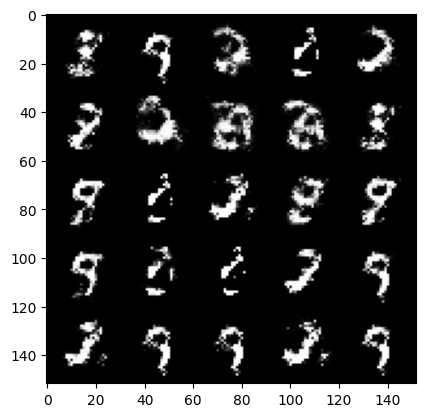

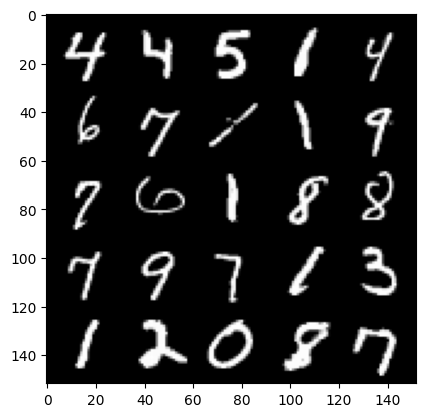

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 39, step 23500: Generator loss: 3.802040260314945, discriminator loss: 0.15457790004462005


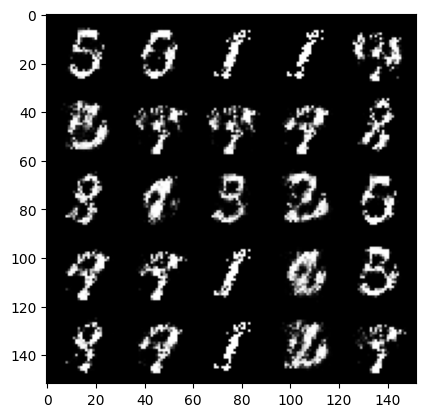

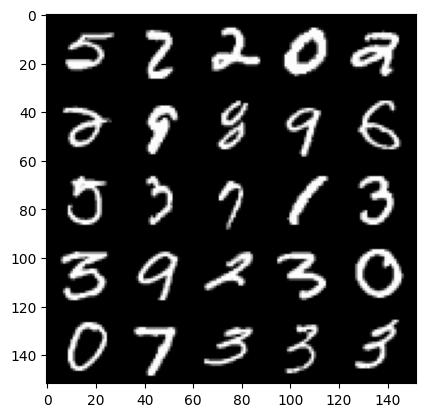

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 40, step 24000: Generator loss: 3.3099333014488206, discriminator loss: 0.17299637636542306


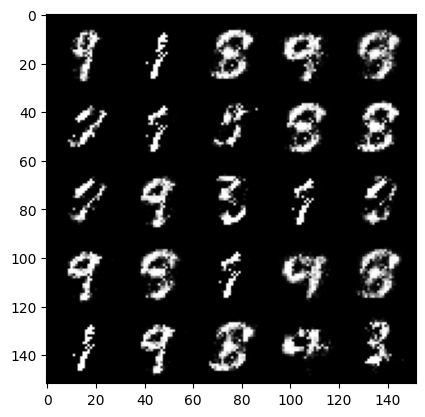

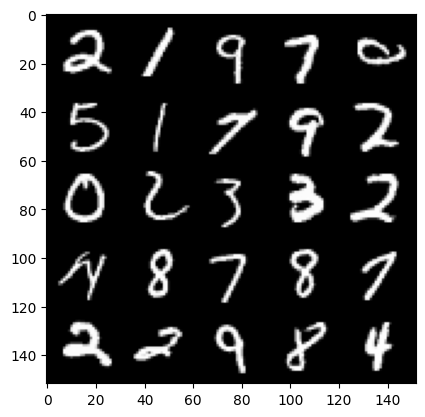

Epoch 40, step 24500: Generator loss: 3.379938126564027, discriminator loss: 0.1707988402545451


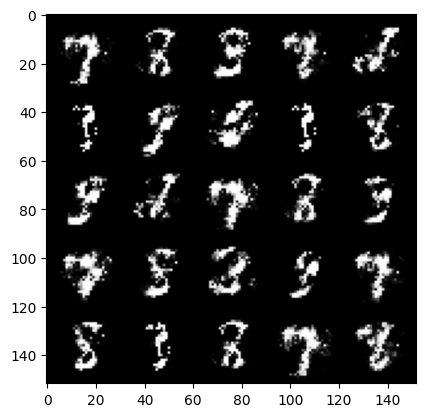

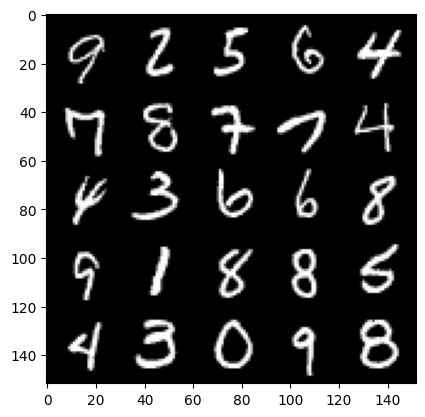

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 41, step 25000: Generator loss: 3.7176216316223165, discriminator loss: 0.14642940676957378


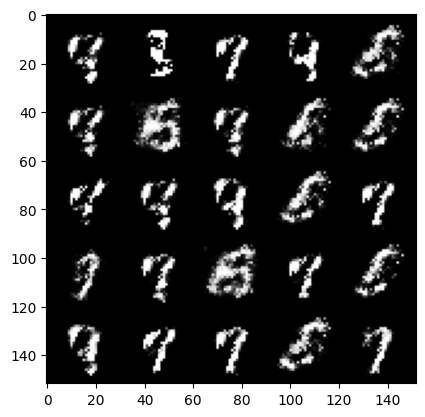

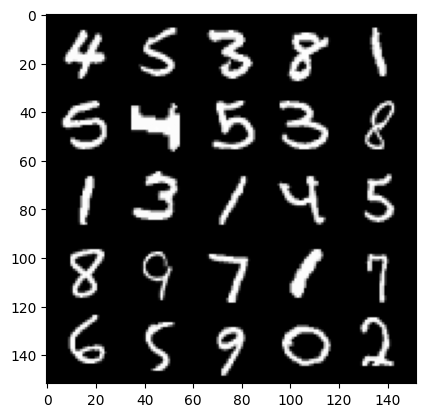

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 42, step 25500: Generator loss: 3.255760392665864, discriminator loss: 0.1793073812574148


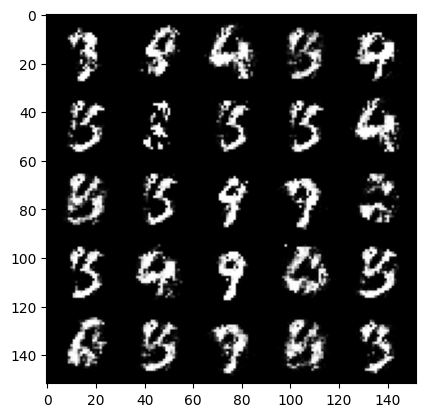

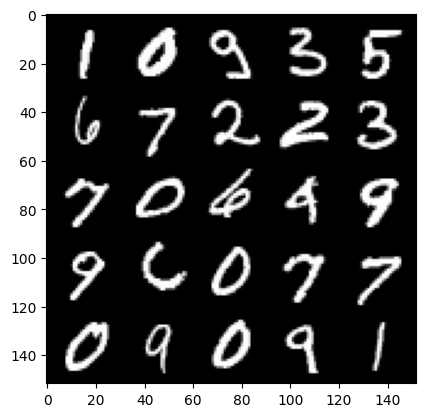

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 43, step 26000: Generator loss: 3.487435875415801, discriminator loss: 0.16917638415098205


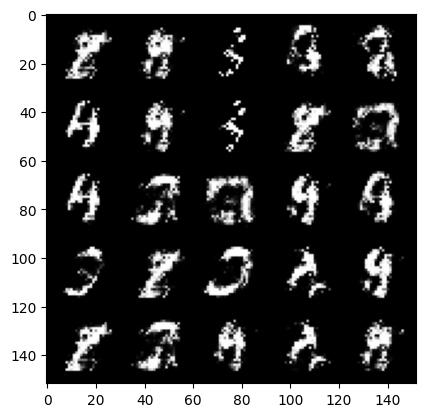

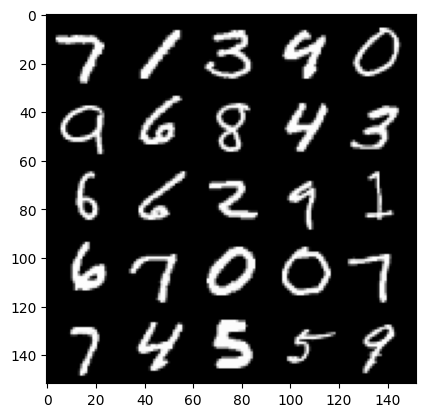

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 44, step 26500: Generator loss: 3.1685804171562184, discriminator loss: 0.18836101584136494


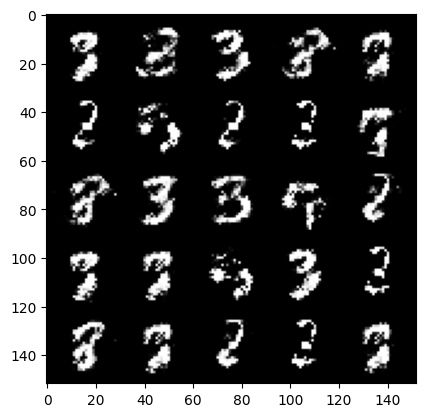

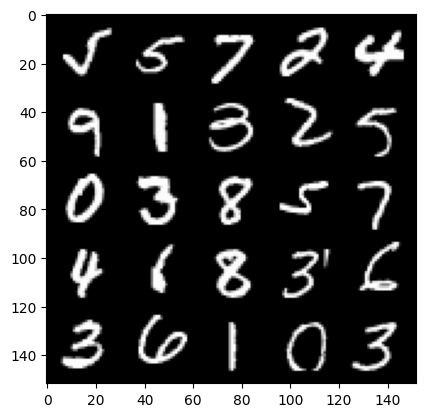

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 45, step 27000: Generator loss: 3.043589078426362, discriminator loss: 0.1989437798783183


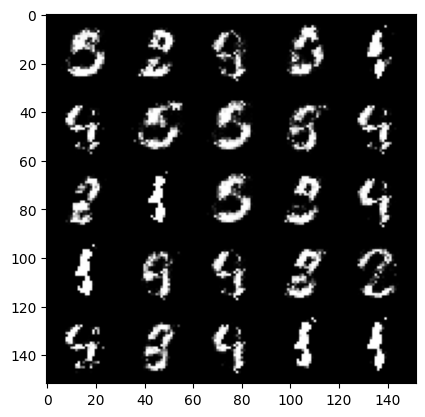

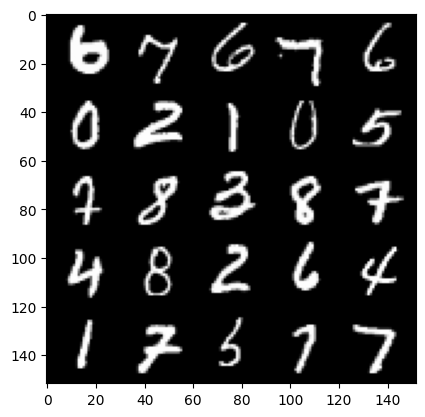

Epoch 45, step 27500: Generator loss: 3.088956491947174, discriminator loss: 0.19773083631694333


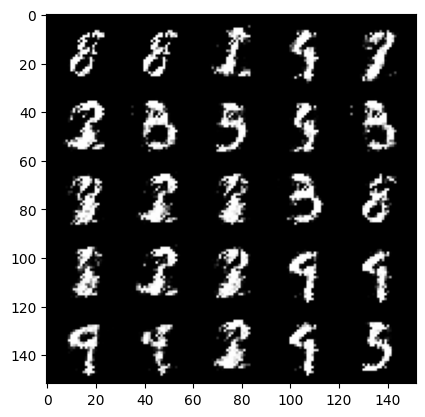

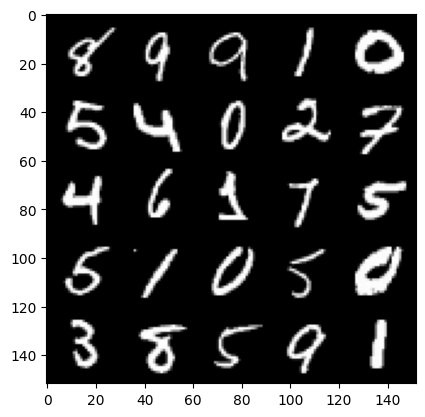

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 46, step 28000: Generator loss: 3.1916592292785633, discriminator loss: 0.1927575601637365


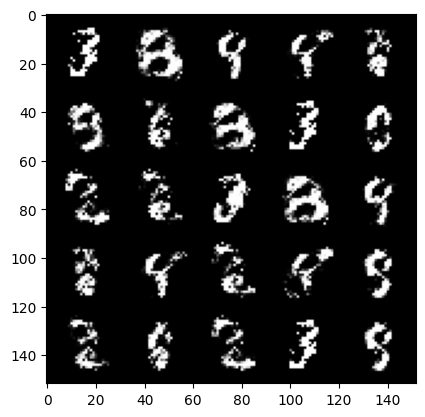

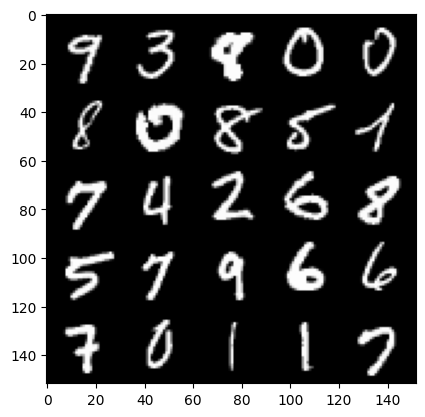

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 47, step 28500: Generator loss: 2.8775067663192737, discriminator loss: 0.2173559482097626


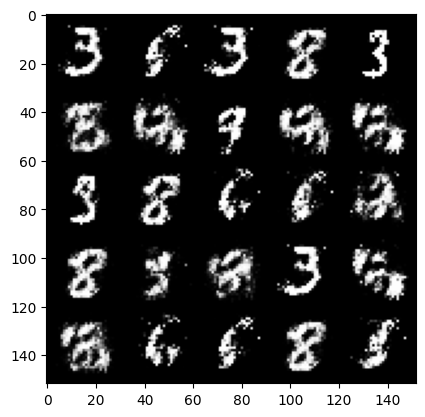

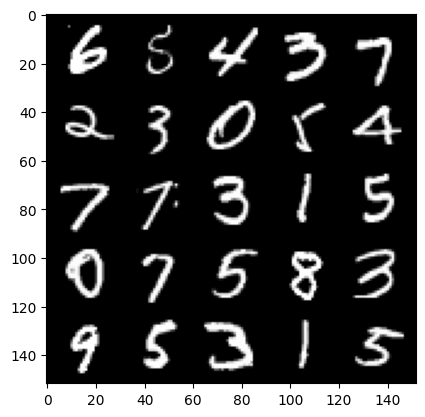

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 48, step 29000: Generator loss: 2.8573825469017042, discriminator loss: 0.21352926363050936


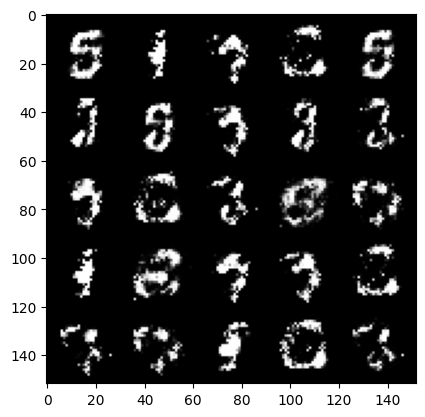

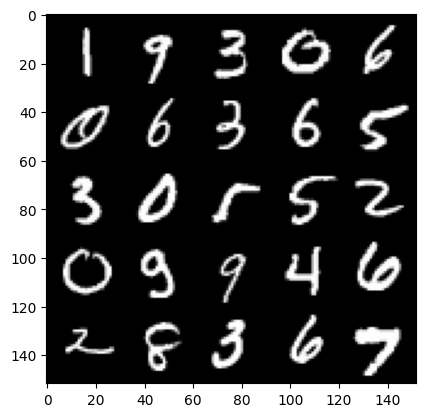

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 49, step 29500: Generator loss: 2.9393371801376333, discriminator loss: 0.21000426036119474


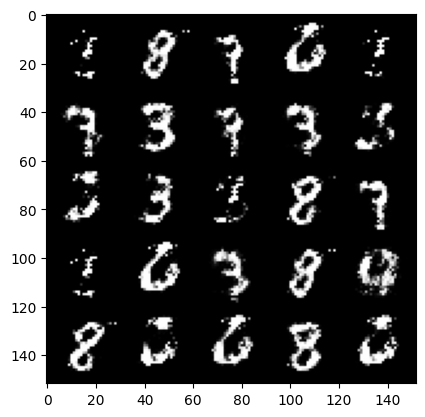

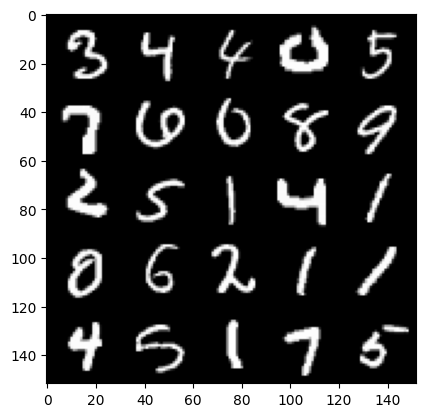

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 50, step 30000: Generator loss: 2.99720969724655, discriminator loss: 0.19034782455861576


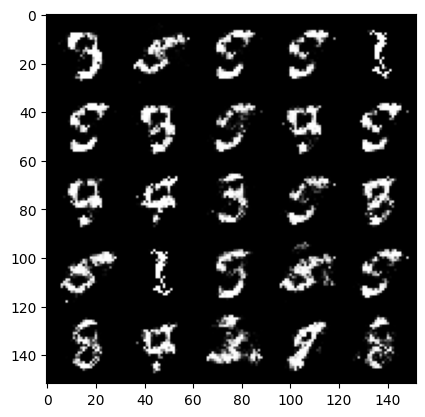

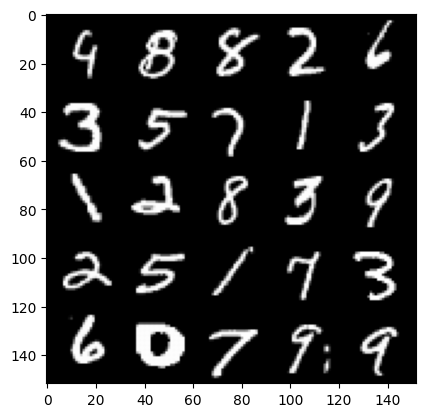

Epoch 50, step 30500: Generator loss: 2.8471096539497416, discriminator loss: 0.23160063605010536


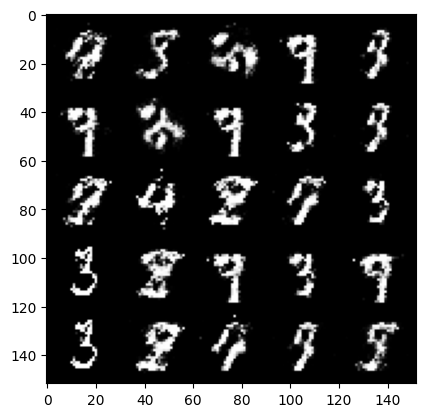

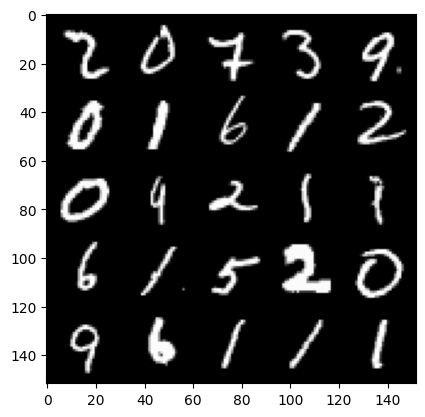

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 51, step 31000: Generator loss: 2.709212763309476, discriminator loss: 0.24418001224100577


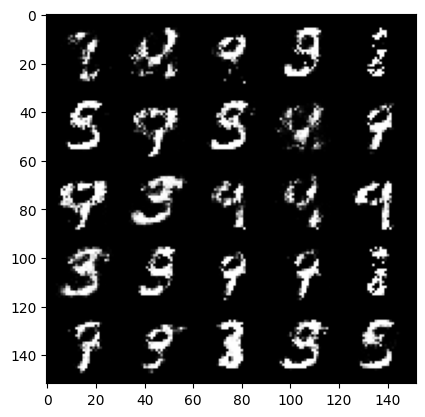

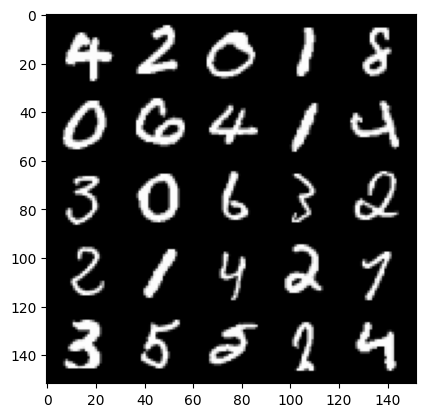

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 52, step 31500: Generator loss: 2.797458881378175, discriminator loss: 0.24632911431789367


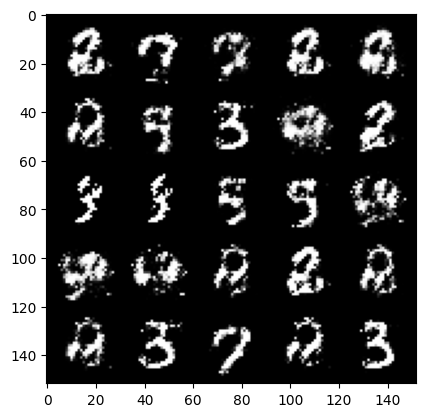

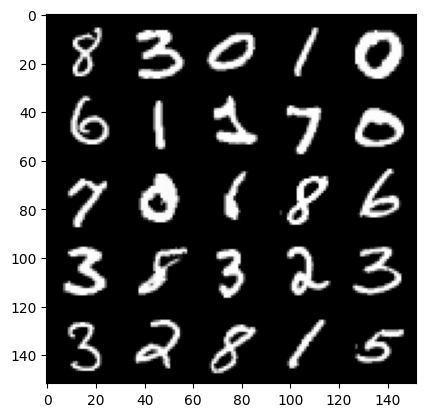

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 53, step 32000: Generator loss: 2.7684834947586086, discriminator loss: 0.22572321128845196


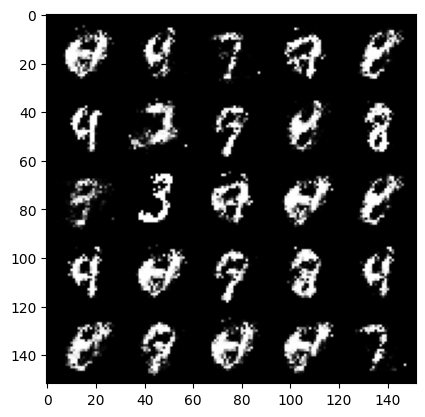

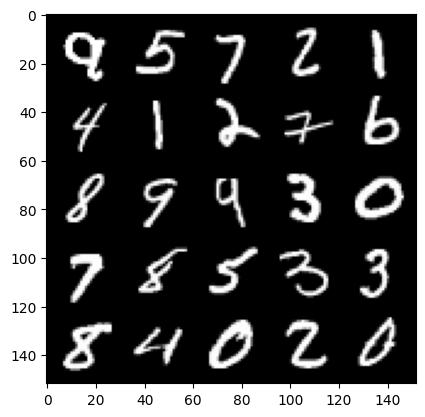

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 54, step 32500: Generator loss: 2.70877709722519, discriminator loss: 0.23440614601969711


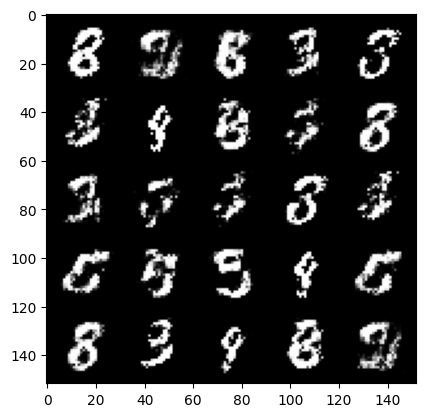

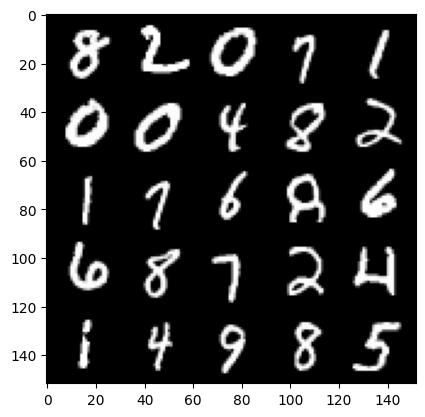

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 55, step 33000: Generator loss: 2.8776898703575133, discriminator loss: 0.22310956670343848


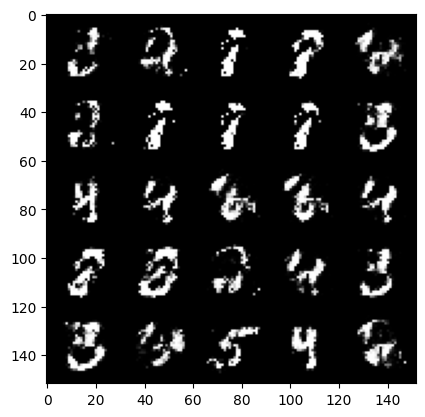

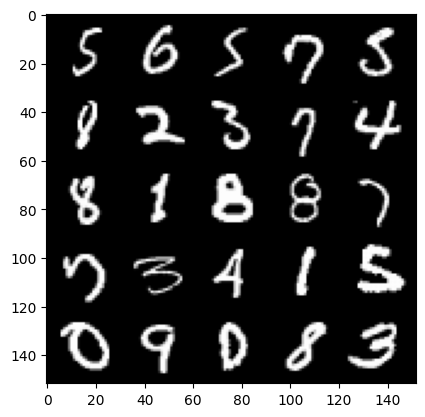

Epoch 55, step 33500: Generator loss: 3.024352323055271, discriminator loss: 0.20665274129807962


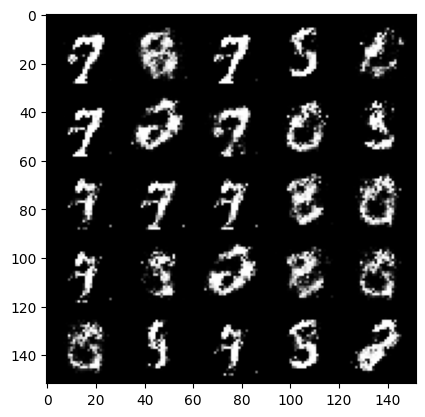

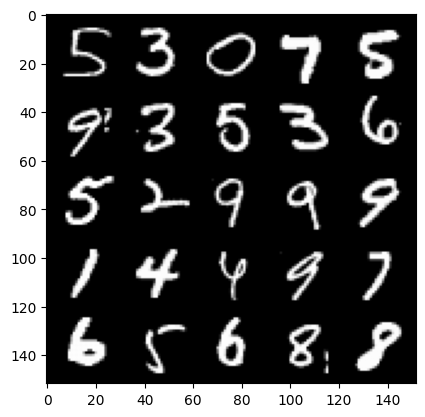

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 56, step 34000: Generator loss: 3.233232366561888, discriminator loss: 0.1957172484248875


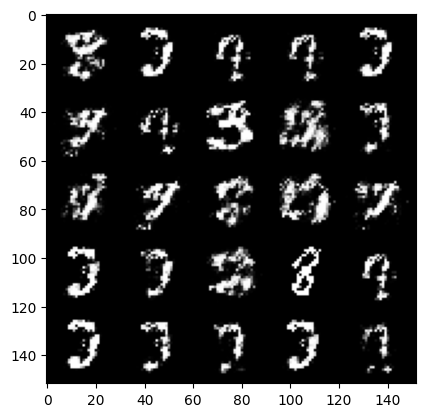

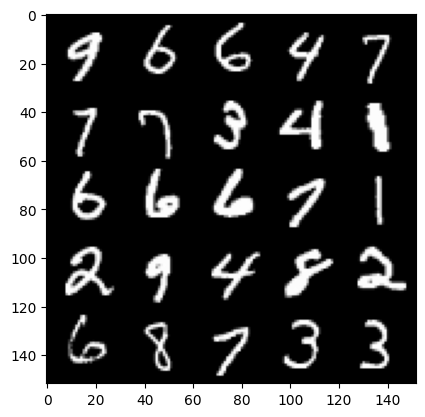

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 57, step 34500: Generator loss: 2.888240654706954, discriminator loss: 0.22132491093874


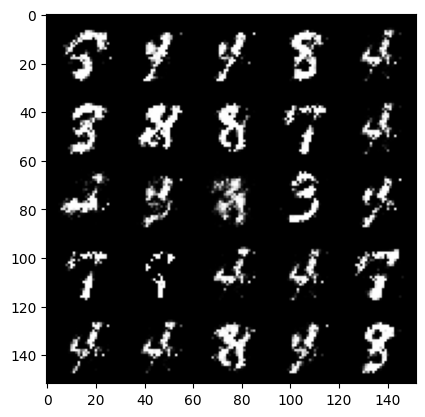

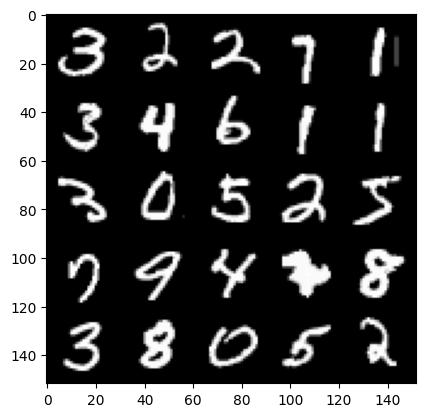

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 58, step 35000: Generator loss: 3.1403701930046064, discriminator loss: 0.1923050569742919


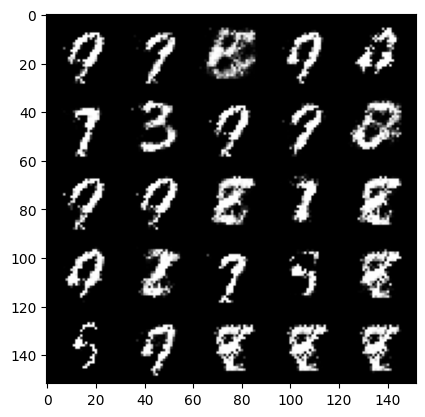

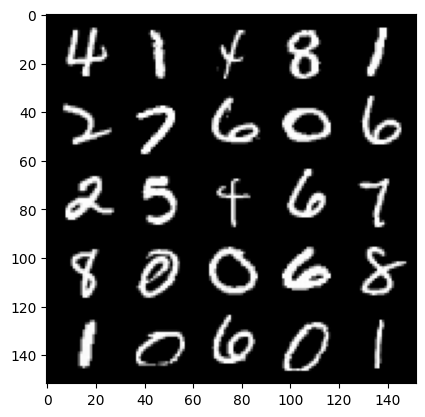

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 59, step 35500: Generator loss: 3.0842789173126226, discriminator loss: 0.20425059635937218


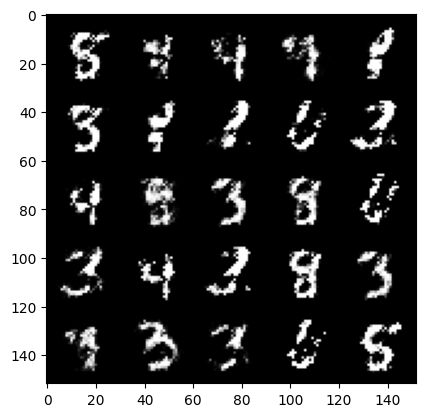

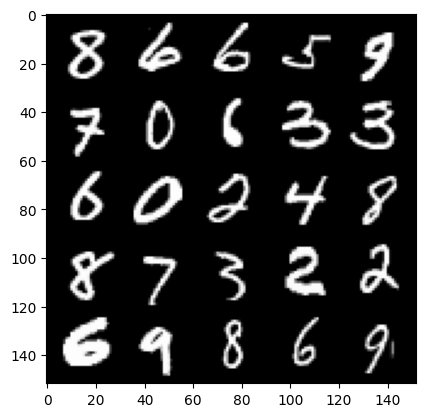

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 60, step 36000: Generator loss: 3.1643543214797982, discriminator loss: 0.1953285320252179


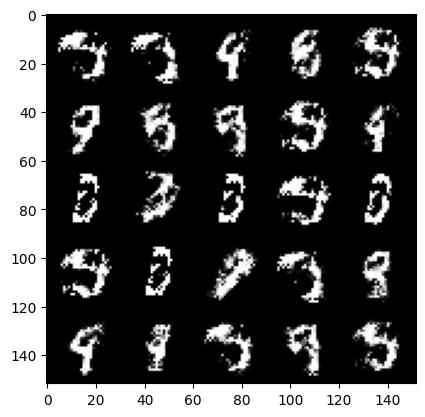

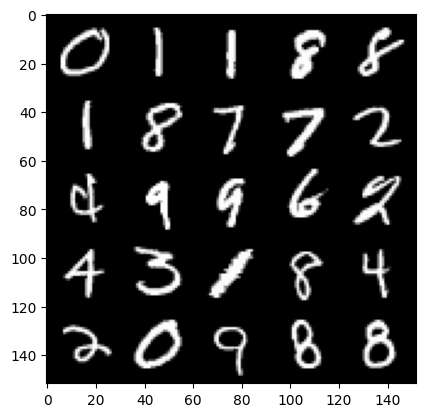

Epoch 60, step 36500: Generator loss: 3.1216476941108726, discriminator loss: 0.20121168665587913


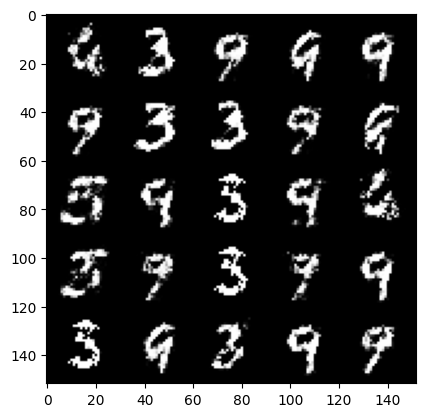

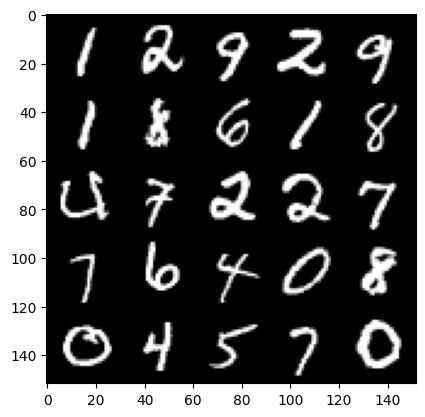

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 61, step 37000: Generator loss: 3.0001567702293426, discriminator loss: 0.20860800433158871


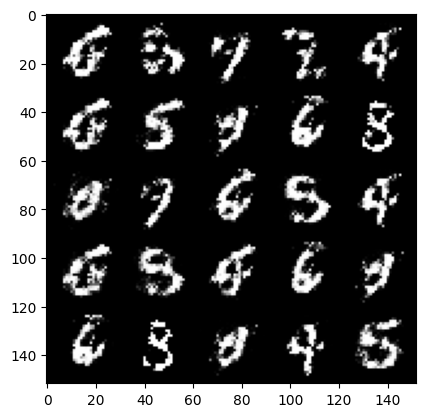

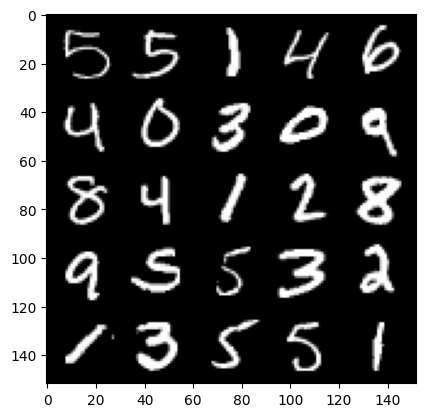

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 62, step 37500: Generator loss: 2.7708266725540143, discriminator loss: 0.2312168154269457


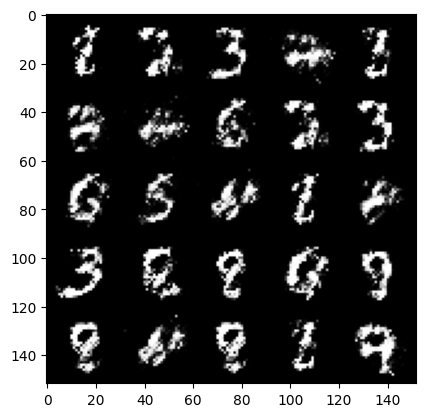

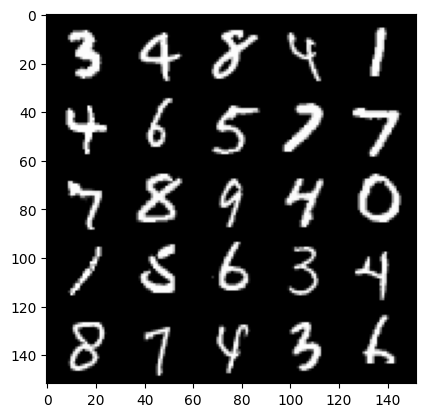

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 63, step 38000: Generator loss: 2.7900616059303283, discriminator loss: 0.2252504950016738


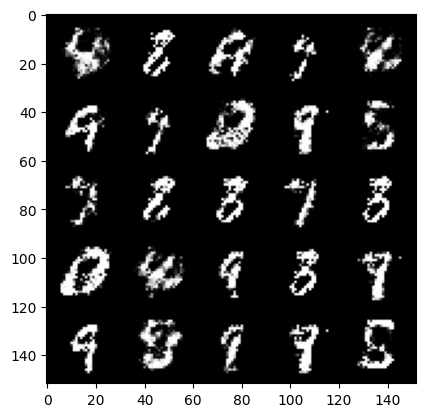

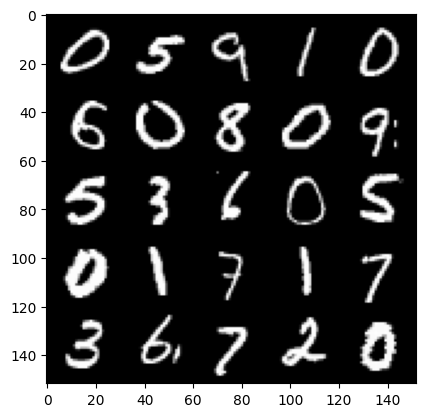

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 64, step 38500: Generator loss: 2.947956157684329, discriminator loss: 0.22299231784045698


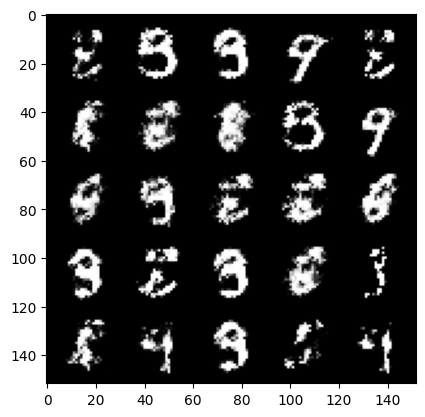

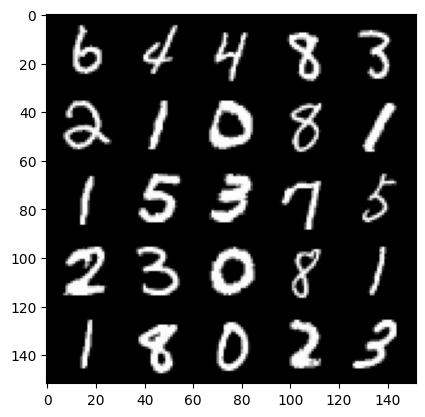

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 65, step 39000: Generator loss: 2.8306016993522647, discriminator loss: 0.2331402024328711


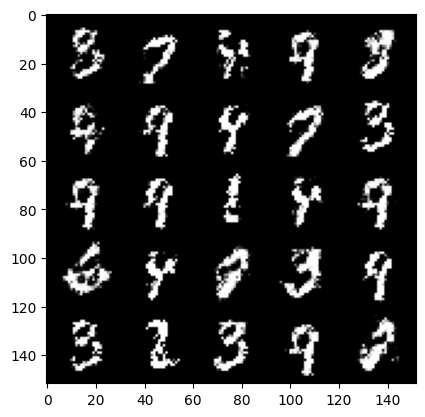

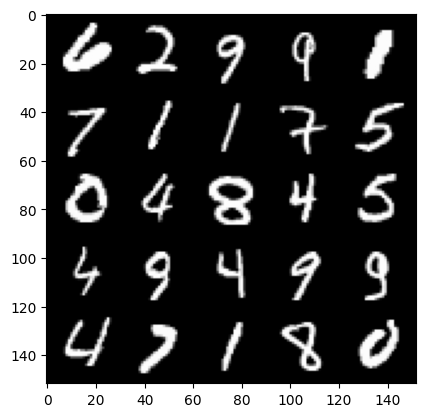

Epoch 65, step 39500: Generator loss: 2.900722165584564, discriminator loss: 0.23207054652273665


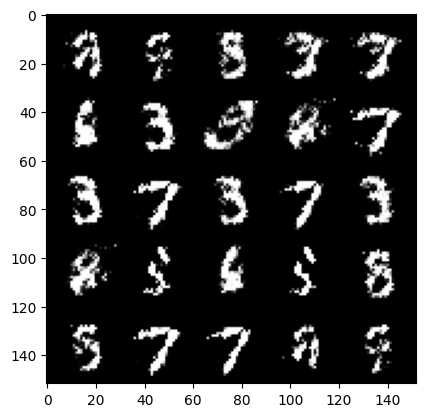

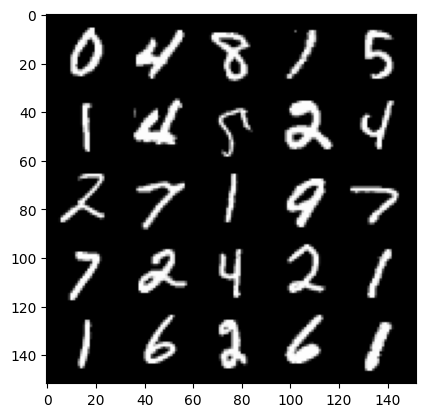

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 66, step 40000: Generator loss: 2.5785524761676784, discriminator loss: 0.24695542293787023


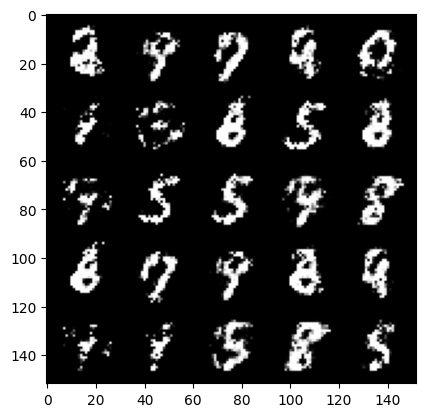

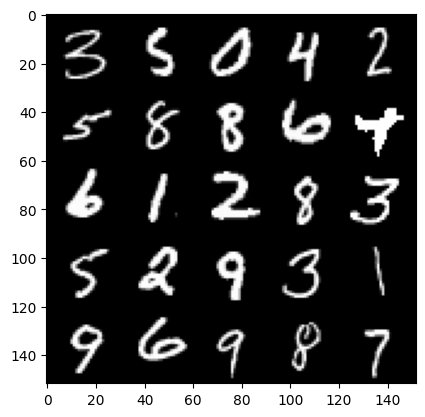

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 67, step 40500: Generator loss: 2.715341619491578, discriminator loss: 0.2421385130882264


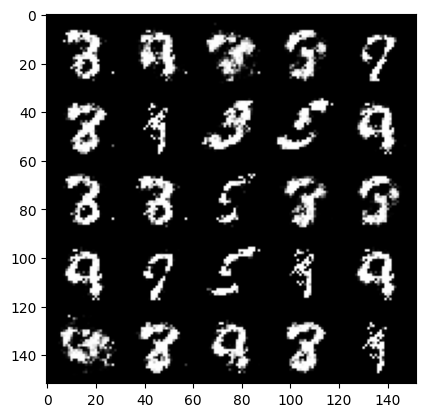

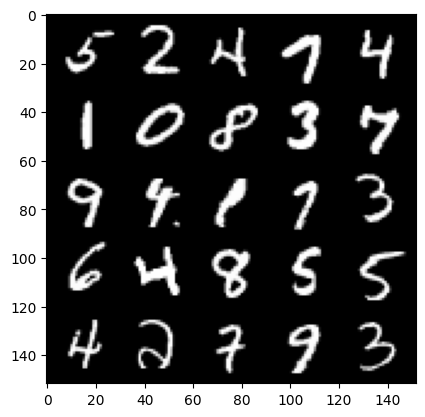

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 68, step 41000: Generator loss: 2.7999881086349463, discriminator loss: 0.23432952377200134


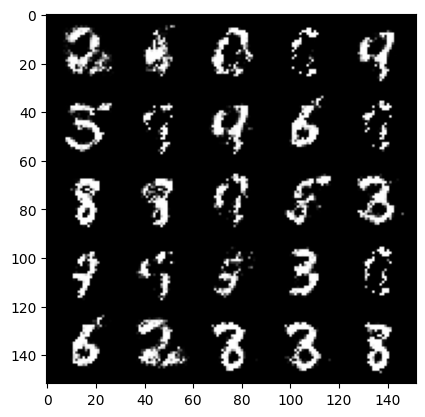

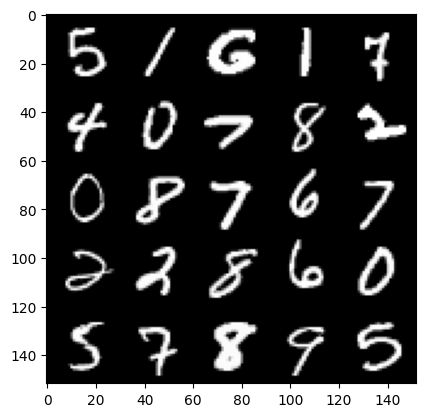

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 69, step 41500: Generator loss: 2.837411094188688, discriminator loss: 0.22250741466879836


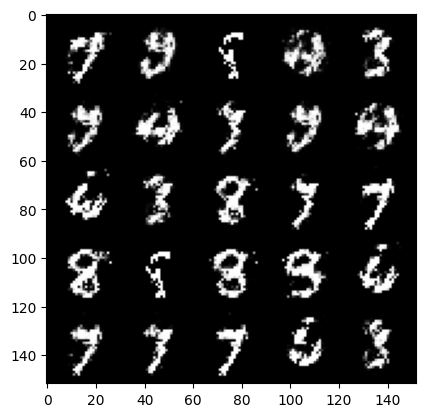

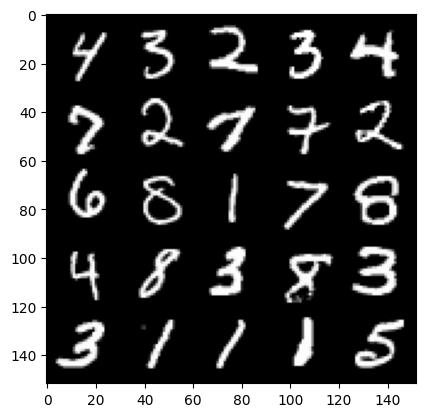

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 70, step 42000: Generator loss: 2.9968890438079834, discriminator loss: 0.1987969938069583


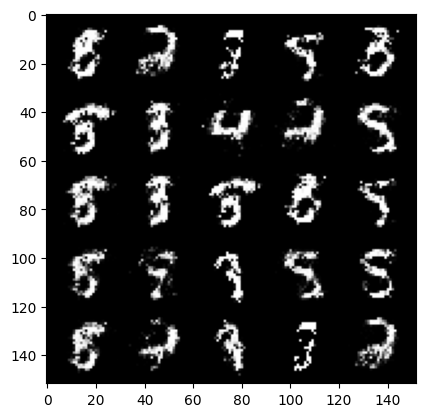

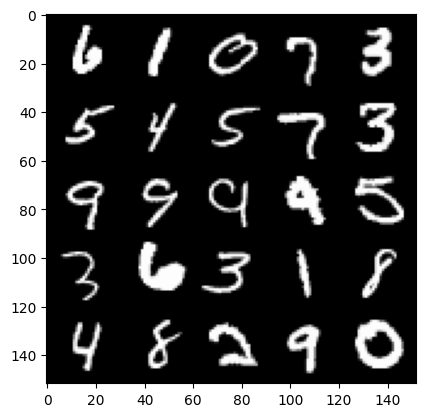

Epoch 70, step 42500: Generator loss: 2.904994575500487, discriminator loss: 0.22041095519065845


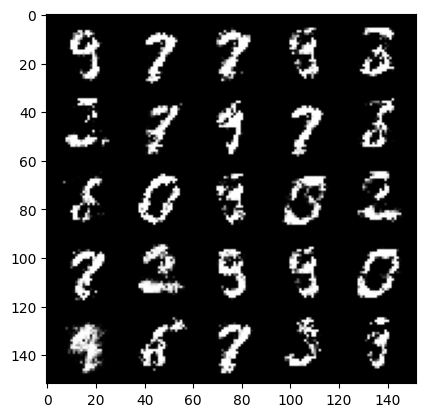

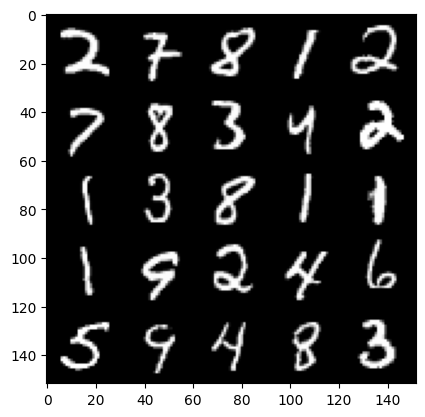

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 71, step 43000: Generator loss: 2.77206963968277, discriminator loss: 0.2301499080806971


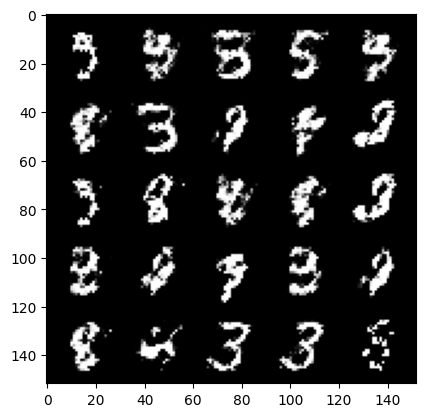

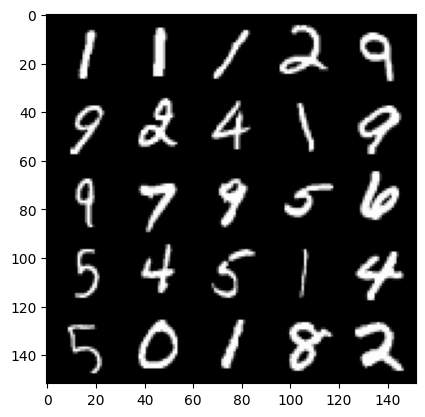

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 72, step 43500: Generator loss: 2.629902880668637, discriminator loss: 0.2608337013125419


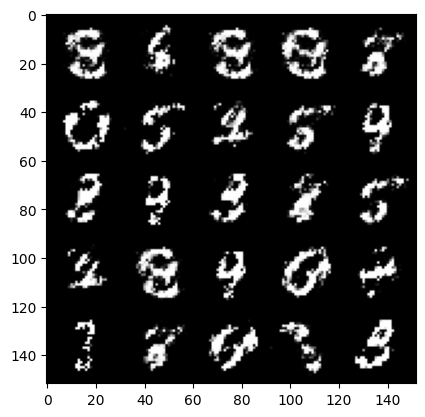

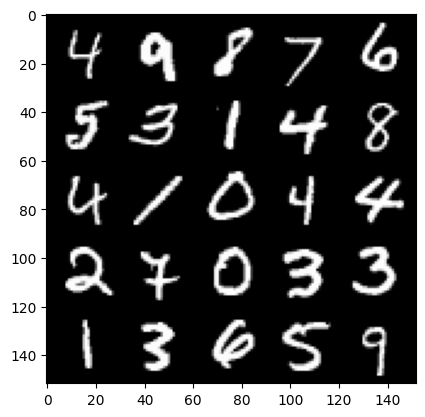

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 73, step 44000: Generator loss: 2.6700816192626977, discriminator loss: 0.24873959535360327


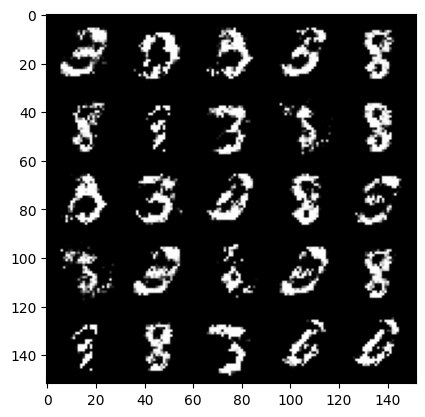

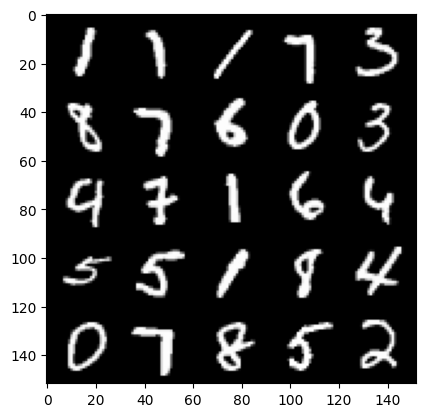

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 74, step 44500: Generator loss: 2.8046631970405556, discriminator loss: 0.22104205803573124


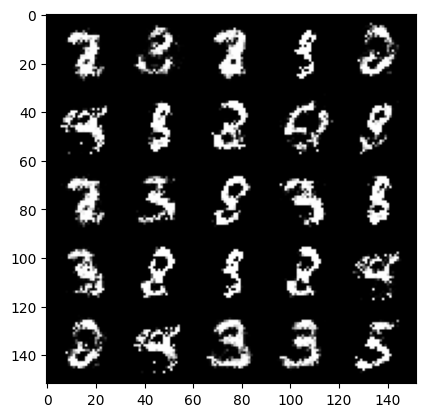

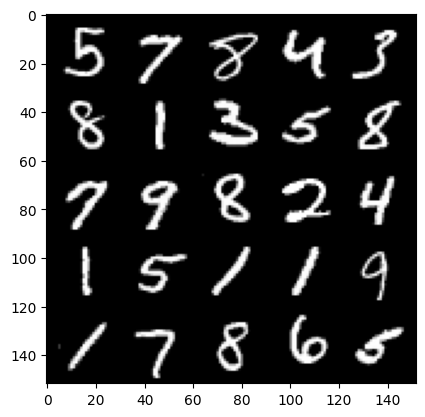

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 75, step 45000: Generator loss: 2.7863312830925, discriminator loss: 0.23253386989235897


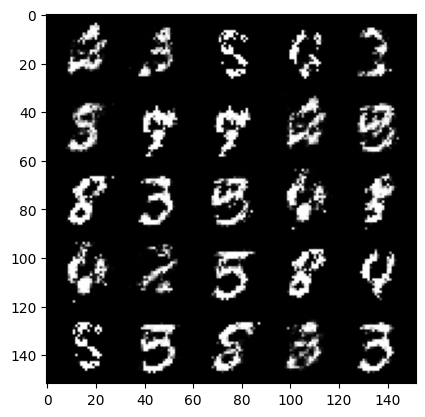

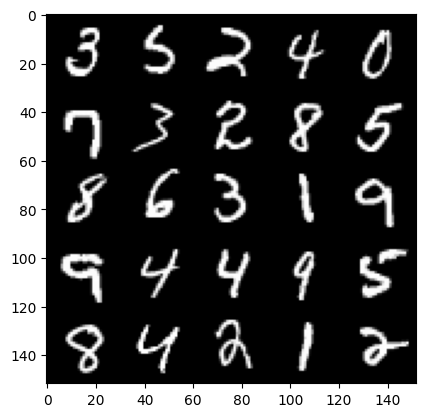

Epoch 75, step 45500: Generator loss: 2.890838727951048, discriminator loss: 0.21792361335456356


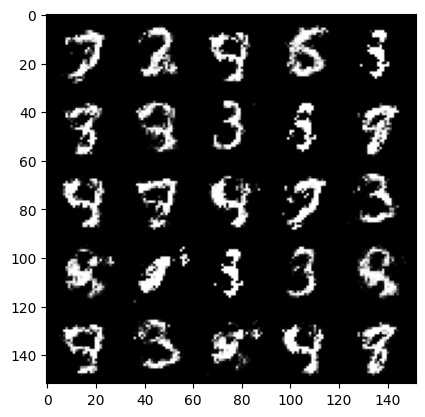

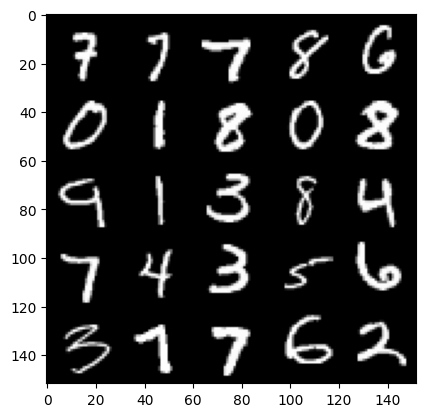

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 76, step 46000: Generator loss: 2.7712090387344364, discriminator loss: 0.23537483315169816


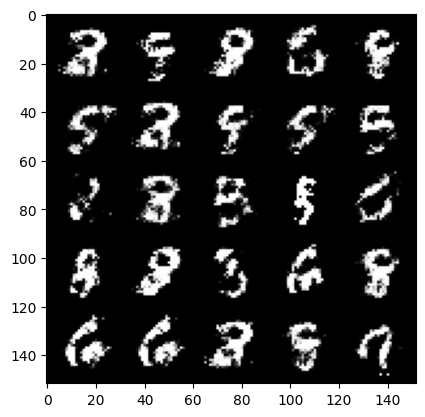

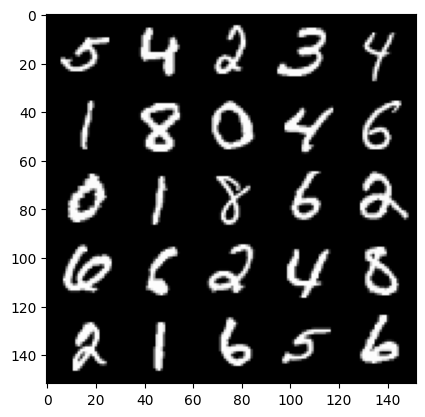

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 77, step 46500: Generator loss: 2.8303579072952267, discriminator loss: 0.22112676748633392


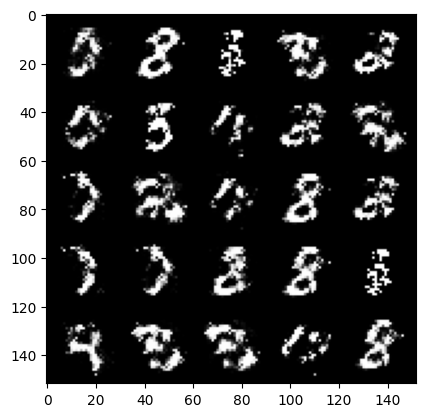

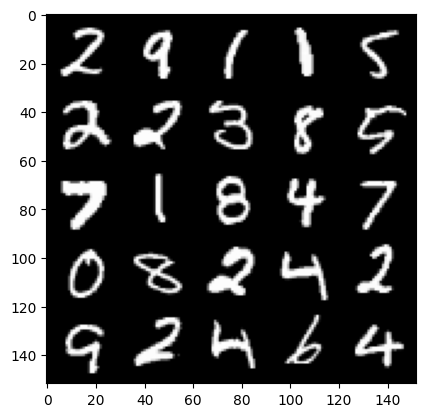

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 78, step 47000: Generator loss: 2.723548824787139, discriminator loss: 0.2518001565933228


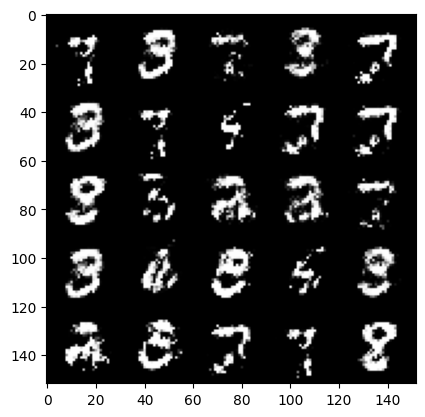

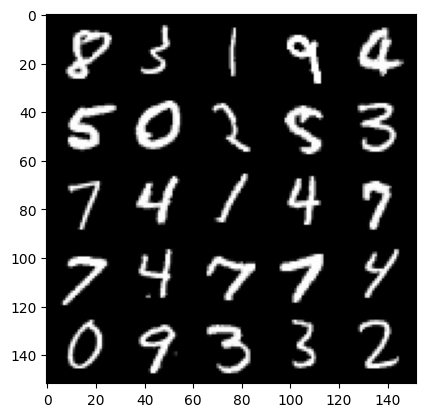

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 79, step 47500: Generator loss: 2.6516232347488384, discriminator loss: 0.238517989858985


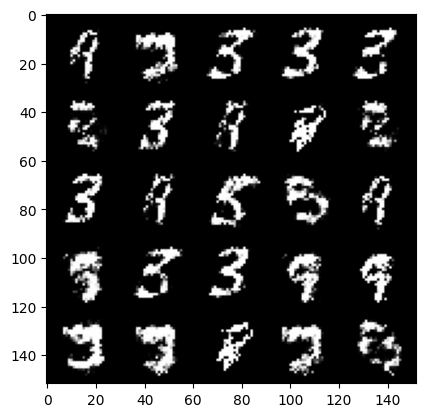

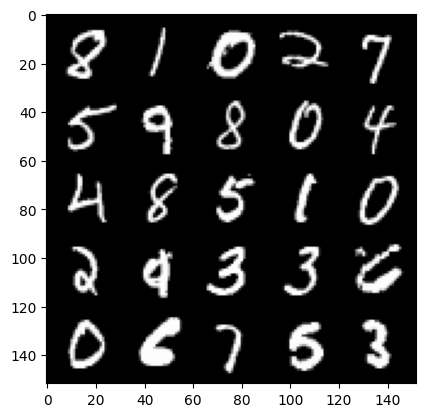

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 80, step 48000: Generator loss: 2.780741245269776, discriminator loss: 0.23958310577273373


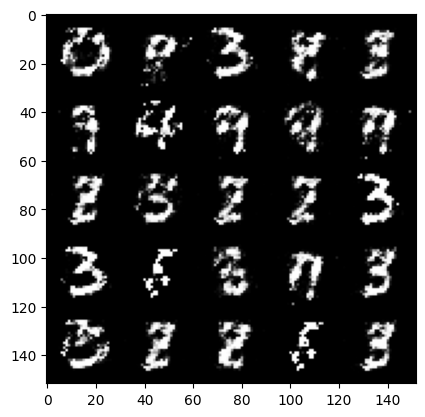

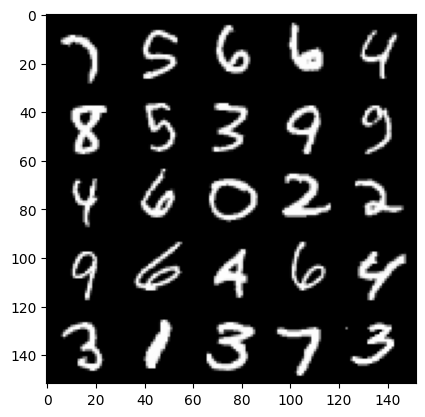

Epoch 80, step 48500: Generator loss: 2.8304831199646006, discriminator loss: 0.23695739607512958


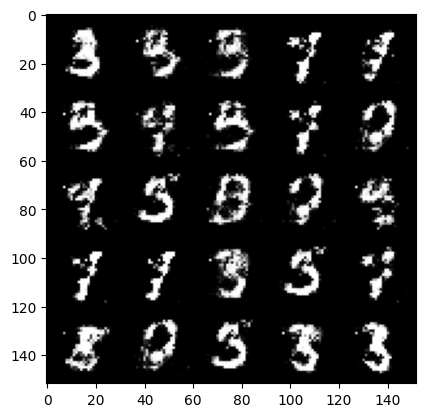

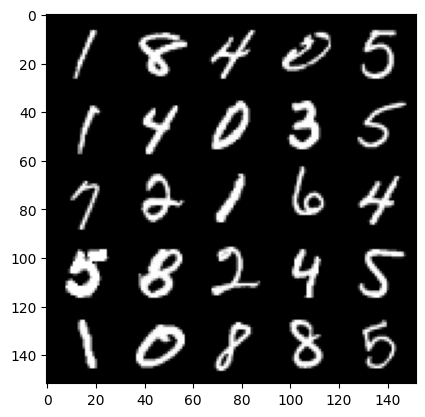

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 81, step 49000: Generator loss: 2.7494666032791137, discriminator loss: 0.2362310988008975


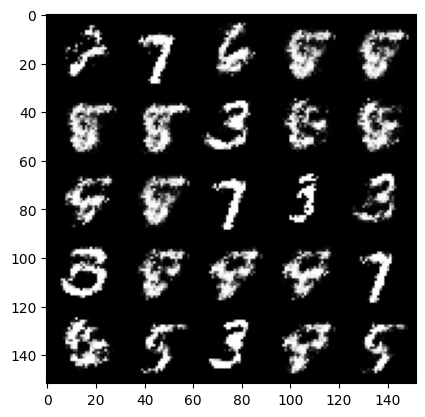

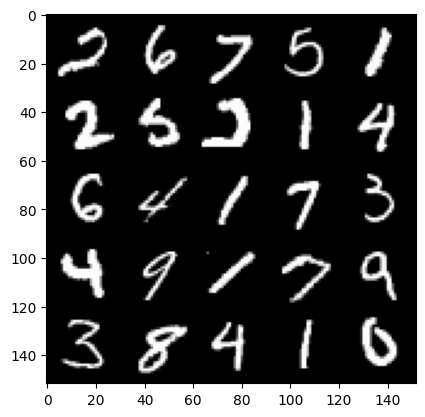

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 82, step 49500: Generator loss: 2.6025793402194988, discriminator loss: 0.260803159058094


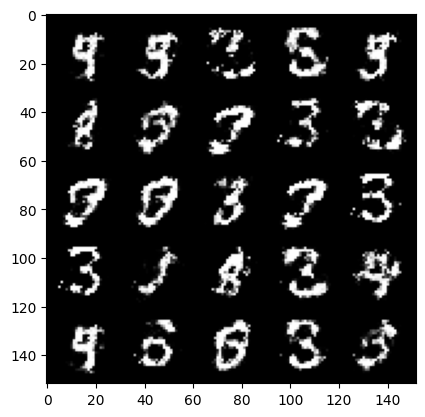

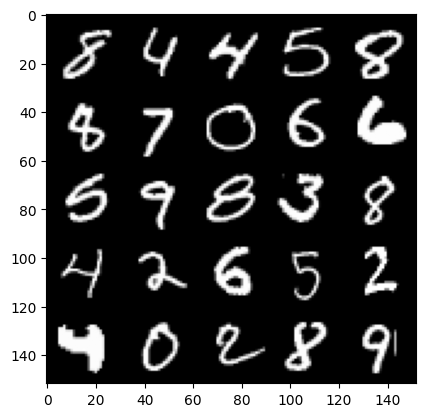

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 83, step 50000: Generator loss: 2.767032640933993, discriminator loss: 0.23683121056854717


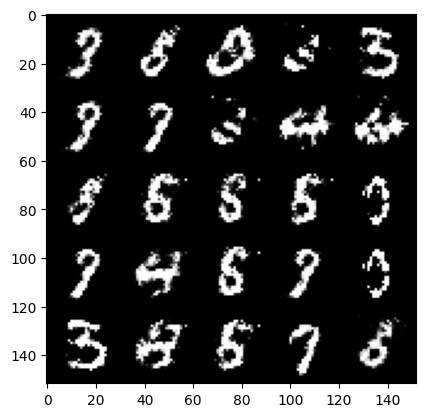

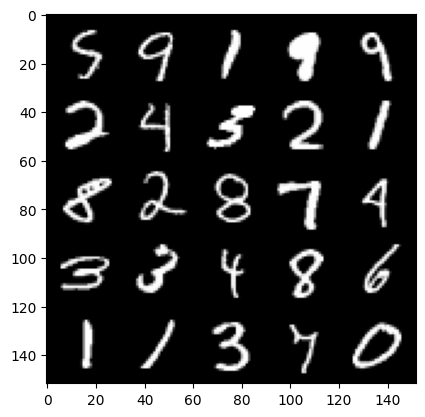

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 84, step 50500: Generator loss: 2.446106993675231, discriminator loss: 0.27556008514761915


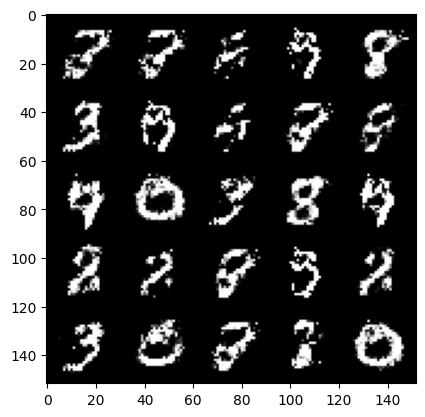

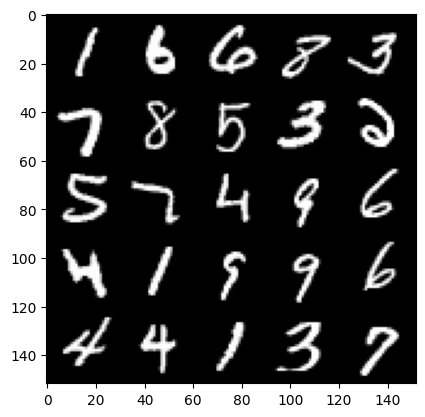

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 85, step 51000: Generator loss: 2.2958710737228394, discriminator loss: 0.2889892211556439


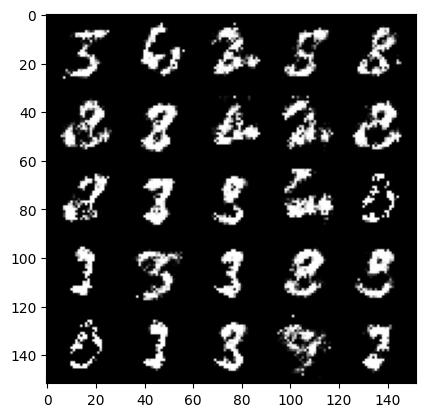

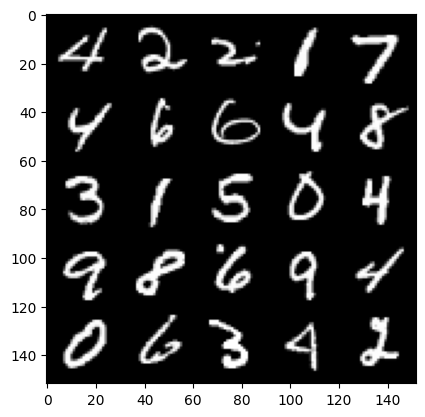

Epoch 85, step 51500: Generator loss: 2.555215192794798, discriminator loss: 0.2699104975312948


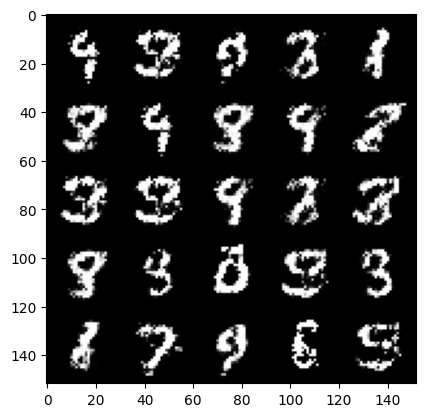

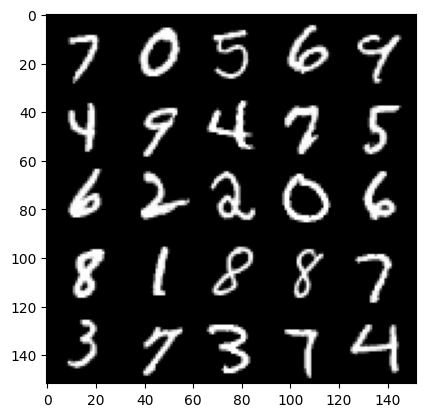

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 86, step 52000: Generator loss: 2.489321997404097, discriminator loss: 0.26085553666949274


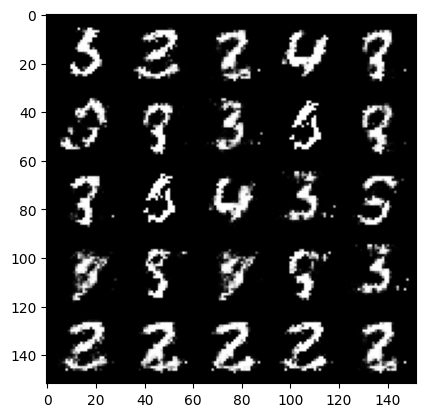

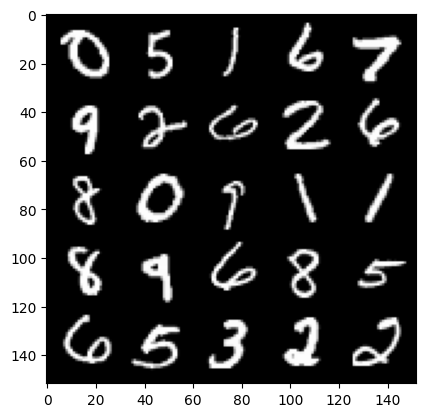

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 87, step 52500: Generator loss: 2.5975499162673934, discriminator loss: 0.2540879737436769


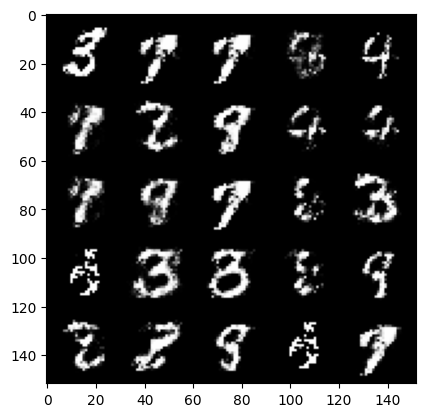

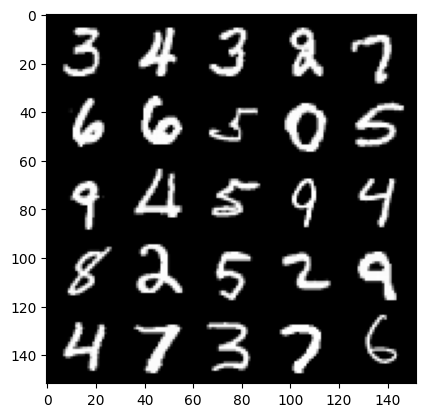

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 88, step 53000: Generator loss: 2.8037216606140136, discriminator loss: 0.22413609343767169


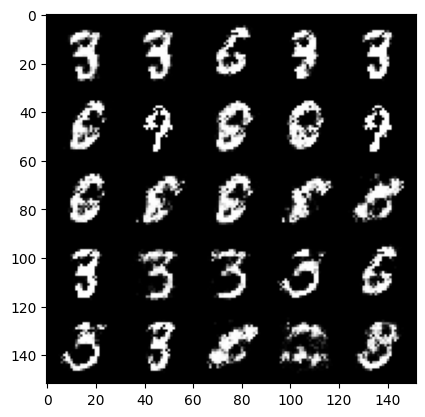

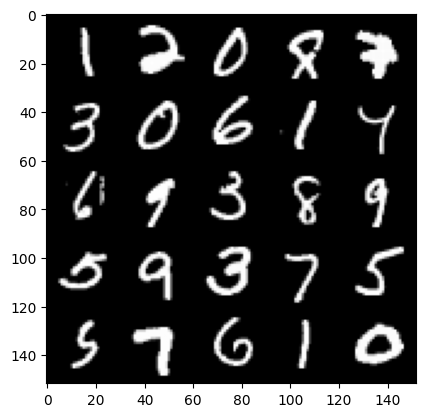

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 89, step 53500: Generator loss: 2.632821270942688, discriminator loss: 0.23618316188454597


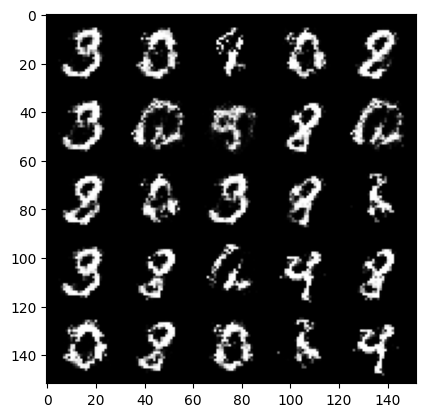

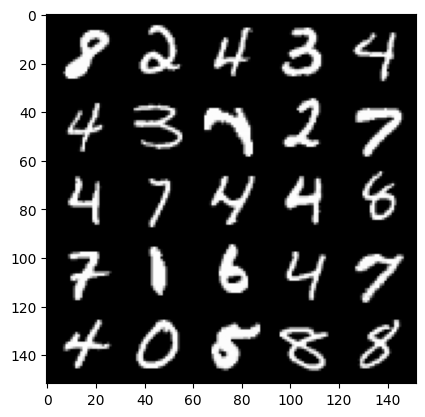

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 90, step 54000: Generator loss: 2.7946972770690883, discriminator loss: 0.22492704822123064


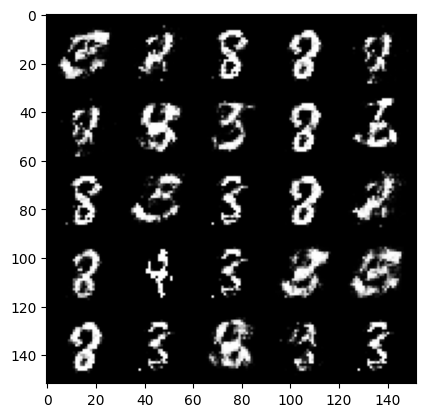

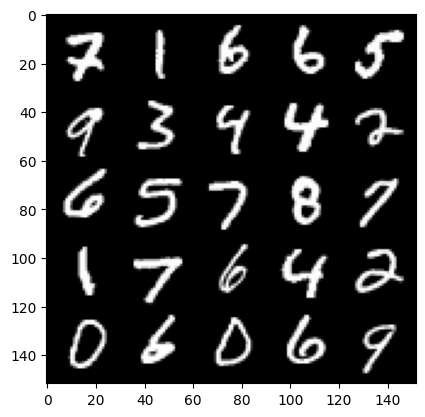

Epoch 90, step 54500: Generator loss: 2.6781975140571586, discriminator loss: 0.22660671007633199


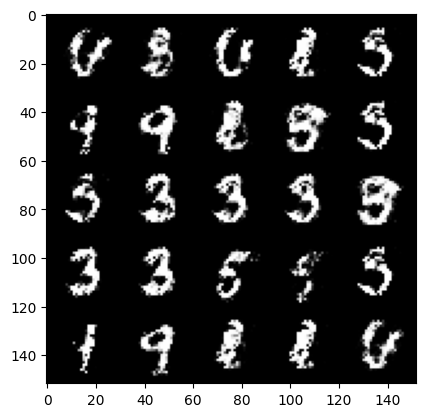

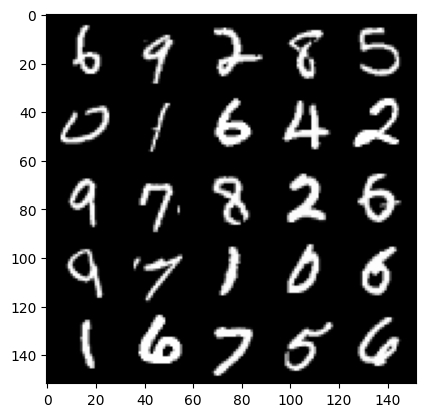

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 91, step 55000: Generator loss: 2.4661565651893635, discriminator loss: 0.26581798723340033


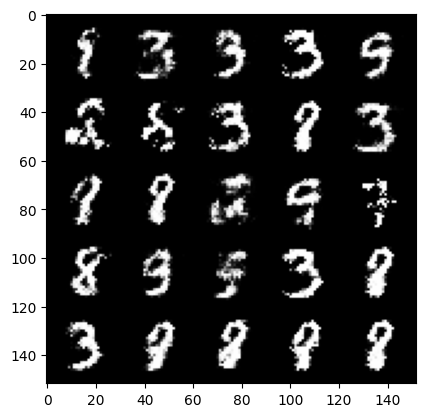

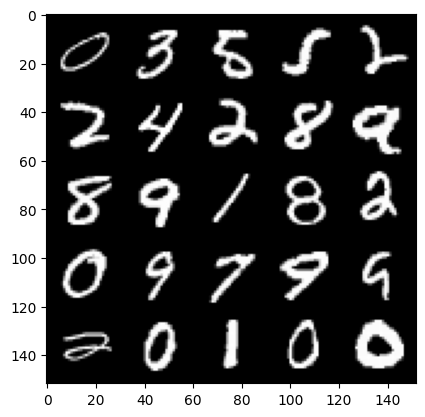

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 92, step 55500: Generator loss: 2.4564206869602203, discriminator loss: 0.2662936602830887


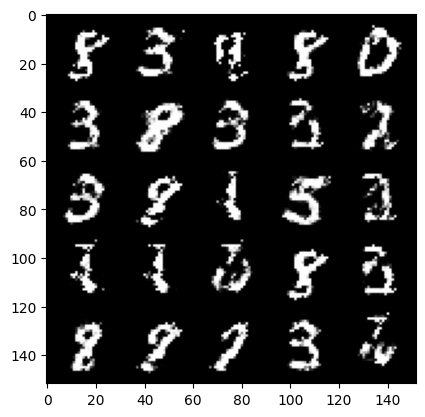

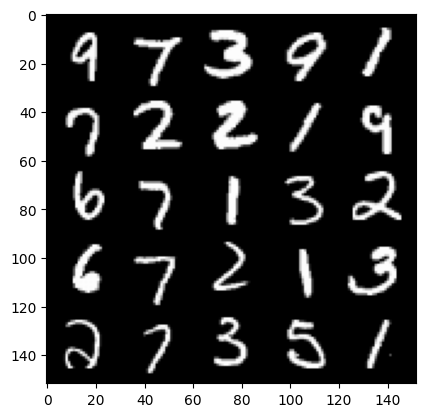

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 93, step 56000: Generator loss: 2.3883386113643623, discriminator loss: 0.28499869987368576


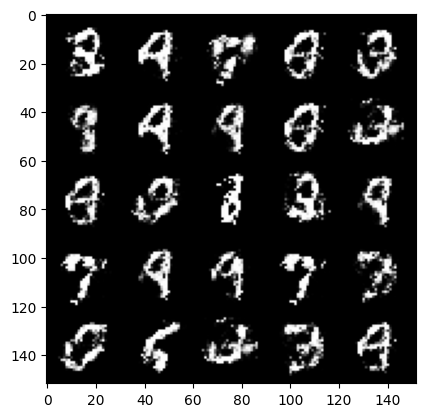

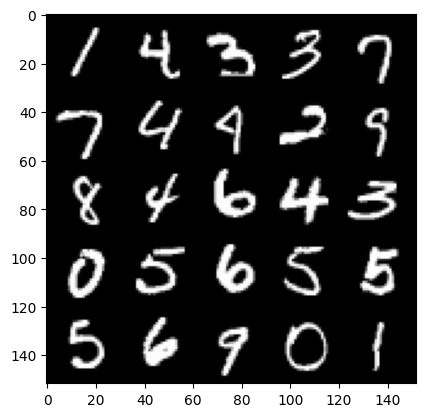

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 94, step 56500: Generator loss: 2.591633659362793, discriminator loss: 0.26400869131088245


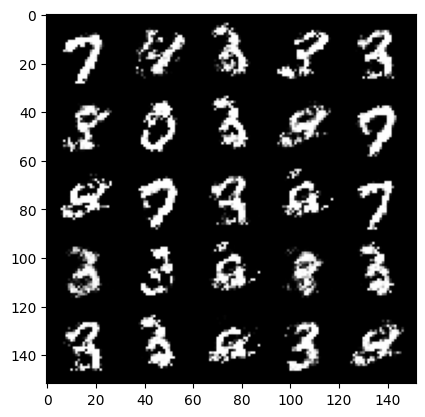

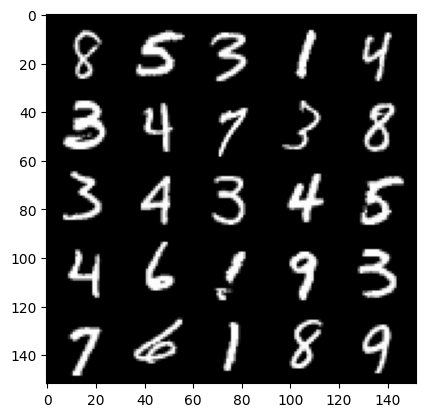

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 95, step 57000: Generator loss: 2.486494425296784, discriminator loss: 0.26580784523487094


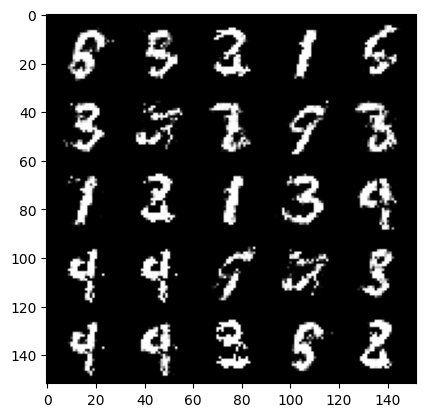

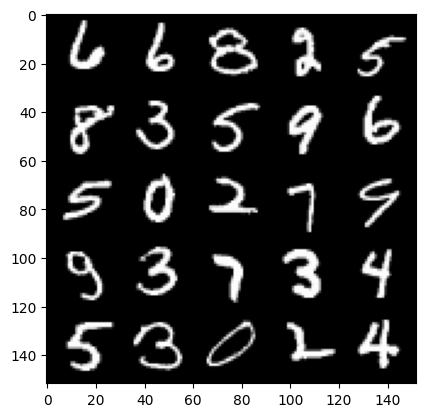

Epoch 95, step 57500: Generator loss: 2.3992056858539597, discriminator loss: 0.28570843926072115


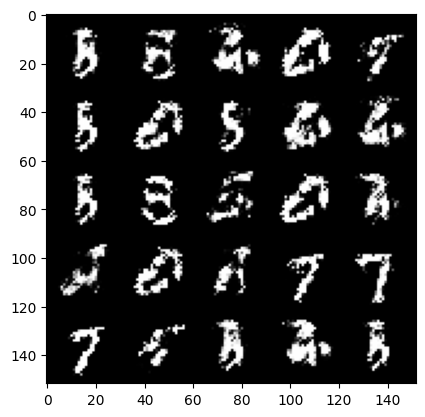

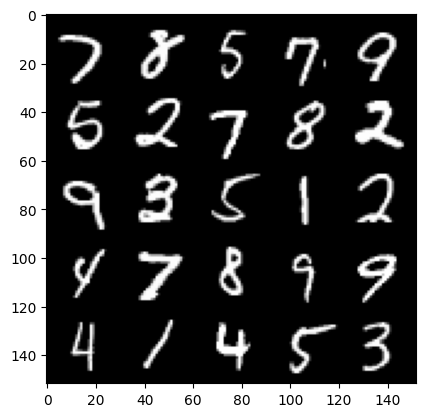

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 96, step 58000: Generator loss: 2.5493900947570785, discriminator loss: 0.271551618605852


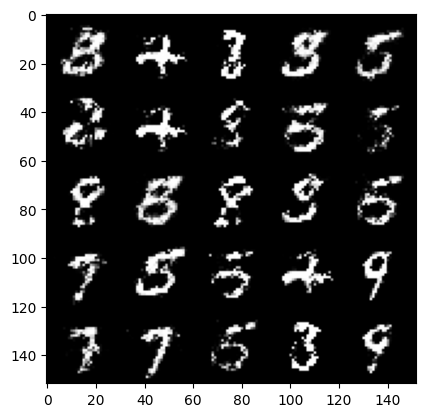

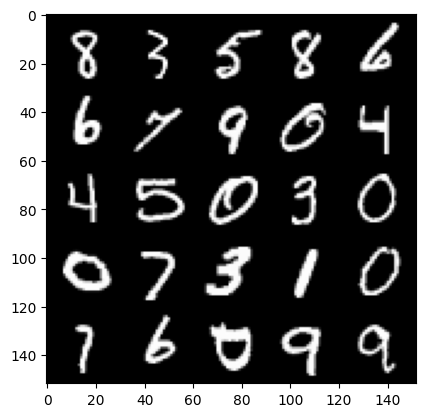

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 97, step 58500: Generator loss: 2.403012333869933, discriminator loss: 0.2766540065109732


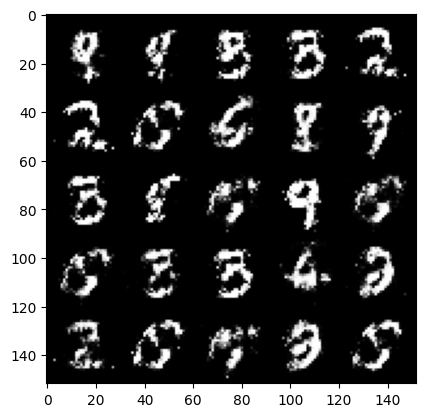

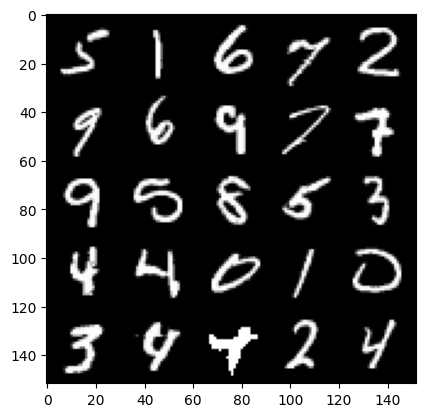

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 98, step 59000: Generator loss: 2.51587582206726, discriminator loss: 0.24169223593175404


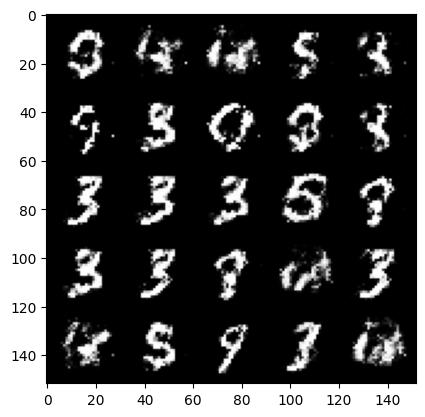

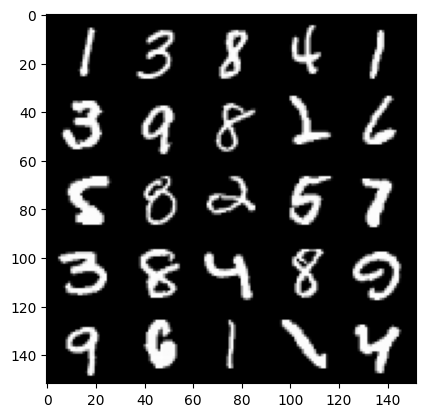

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch 99, step 59500: Generator loss: 2.765647102355956, discriminator loss: 0.2349229118824005


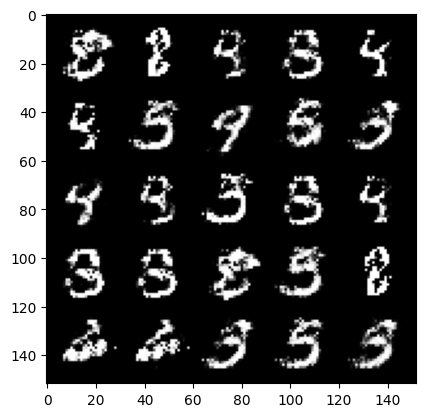

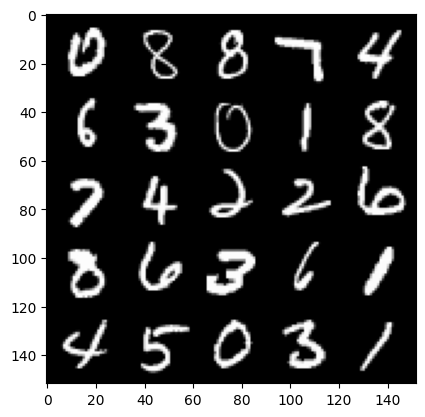

In [36]:
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
gen_loss = False
error = False
for epoch in range(n_epochs):

    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)

        # Flatten the batch of real images from the dataset
        real = real.view(cur_batch_size, -1).to(device)

        ### Update discriminator ###
        # Zero out the gradients before backpropagation
        disc_opt.zero_grad()

        # Calculate discriminator loss
        disc_loss = get_disc_loss(gen, disc, criterion, real, cur_batch_size, z_dim, device)

        # Update gradients
        disc_loss.backward(retain_graph=True)

        # Update optimizer
        disc_opt.step()

        ### Update generator ###
        #     Hint: This code will look a lot like the discriminator updates!
        #     These are the steps you will need to complete:
        #       1) Zero out the gradients.
        #       2) Calculate the generator loss, assigning it to gen_loss.
        #       3) Backprop through the generator: update the gradients and optimizer.
        #### START CODE HERE ####
        gen_opt.zero_grad()
        gen_loss = get_gen_loss(gen, disc, criterion, cur_batch_size, z_dim, device)
        gen_loss.backward()
        gen_opt.step()
        #### END CODE HERE ####

        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1

## CHALLENGES FACED:
### 1) Lost connection to the runtime a lot of times because of high number of epochs.
### 2) Mode collapse: With high numbers of z_dim and batch_size like 512, I observed that the discriminator wasn't able to provide a good feedback and the generator generated almost same images throughout the number of epochs.
### 3) The hyperparameters and their values that were used for this experiment is
### n_epochs (number of epochs): 20, 30, 50, 100, 200 (runtime never finished, always got disconnected)
### z_dim (Dimension of noise vector): 64, 70, 80, 96, 100, 128, 256
### batch_size (Number of images per forward/backward pass): 64, 96, 128, 256
### lr (learning rate): 0.0001, 0.0002, 0.00001, 0.00005
### The model was giving poor results with very high number of z_dim and batch_size. But the values that are used were found to be optimal in the given timeframe.
### n_epochs = 100, z_dim = 100, batch_size = 100, lr = 0.0002

## We can see that our model starts having a very raw sense of MNIST numbers from epoch 3 itself where it started with random noise at epoch 0. At epoch 14, we can see couple of 1s and 2s generated by the model. At epoch 17, we can observe that model outputs 3, 4, 5, 8, 9. Epoch 35 gave us good 1, 2, and 4. Epoch 55 has a lots of 7s generated. Epoch 60 has good results of 3, 4, and 9. Epoch 65 has the best generated results throughout the model (1,2,3,4,7,8,9). We can see some 6s generated in epoch 68. The model again tried to generate 6s and 0s in epoch 70. Epoch 83 generated 3s, 5s, 6s, and 7s. Epoch 89 generated 0s, 3s, 4s, 8s, and 9s. Epoch 90 we can see good generations of 1, 3, 5, and 9. So, as per my understanding the model was able to generate all the numbers in different epochs.
## Given the ability to modify the code and more resources, I am sure I can produce a better output. With the limited resources of GPU on Google Colab that I had, I was able to produce these results. Please consider the limit of resources as well in your grading factor.

## Final Comments: I followed the tutorial and now fully understand the concept of GAN's after having a hands-on experience to work on it.
## With the literature review of GAN's using the Ian Goodfellow book and the notes covered in class, I would say that the implementation of MNIST dataset using GANs worked well for me with the final losses obtained as Generator loss: 2.77, discriminator loss: 0.24 (rounded to two decimal places).
